# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

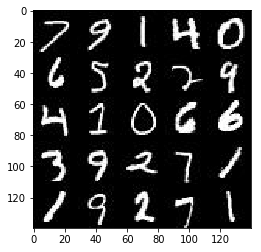

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

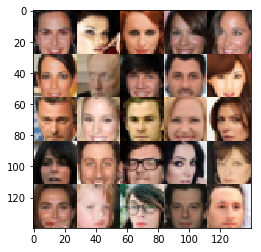

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Functionmodel_inputs
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name = 'input_real') 
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name = 'input_z')
    learning_rate = tf.placeholder(tf.float32, (None))
    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    
    alpha = 0.12    
    with tf.variable_scope('discriminator', reuse = reuse):
        x1 = tf.layers.conv2d(images, 64, 4, strides = 2, padding = "same")
        bn1 = tf.layers.batch_normalization(x1, training = True)
        relu1 = tf.maximum(alpha * bn1, bn1)
        d1 = relu1
        #d1 = tf.layers.dropout(relu1, 0.5)

        x2 = tf.layers.conv2d(d1, 128, 4, strides = 2, padding = "same")
        bn2 = tf.layers.batch_normalization(x2, training = True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        d2 = relu2
        #d2 = tf.layers.dropout(relu2, 0.5)

        x3 = tf.layers.conv2d(d2, 256, 4, strides = 2, padding = "same")
        bn3 = tf.layers.batch_normalization(x3, training = True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        d3 = relu3
        #d3 = tf.layers.dropout(relu3, 0.5)

        flat = tf.reshape(d3, (-1, 4 * 4 * 256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    reuse = not is_train
    alpha = 0.12
    with tf.variable_scope('generator', reuse = reuse):
        x1 = tf.layers.dense(z, 4 * 4 * 512)        
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        bn1 = tf.layers.batch_normalization(x1, training = is_train)       
        relu1 = tf.maximum(alpha * bn1, bn1)
        #d1 = relu1 
        d1 = tf.layers.dropout(relu1, 0.5)
            
        x2 = tf.layers.conv2d_transpose(d1, 256, 4, strides = 1, padding = "valid")
        bn2 = tf.layers.batch_normalization(x2, training = is_train)
        relu2 = tf.maximum(alpha * bn2, bn2)
        #d2 = relu2
        d2 = tf.layers.dropout(relu2, 0.5)
        
        x3 = tf.layers.conv2d_transpose(d2, 128, 4, strides = 2, padding = "same")
        bn3 = tf.layers.batch_normalization(x3, training = is_train)
        relu3 = tf.maximum(alpha * bn3, bn3)
        #d3 = relu3
        d3 = tf.layers.dropout(relu3, 0.5)
        
        logits = tf.layers.conv2d_transpose(d3, out_channel_dim, 4, strides = 2, padding = "same")    
        out = tf.tanh(logits)
        
    return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function    
    
    smooth = 0.1
    g_model = generator(input_z, out_channel_dim, is_train = True)    
    d_model_real, d_logits_real = discriminator(input_real, reuse = False)    
    d_model_fake, d_logits_fake = discriminator(g_model, reuse = True)
    
    # Calculate losses
    d_loss_real = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, 
                                                              labels=tf.ones_like(d_model_real) * (1 - smooth)))
    d_loss_fake = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, 
                                                              labels=tf.zeros_like(d_logits_fake)))
    g_loss = tf.reduce_mean(
                 tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                         labels=tf.ones_like(d_model_fake)))
    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss
 

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    all_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    
    g_update_ops = [var for var in all_update_ops if var.name.startswith('generator')]
    d_update_ops = [var for var in all_update_ops if var.name.startswith('discriminator')]

    with tf.control_dependencies(d_update_ops):
        d_train_opt = tf.train.AdamOptimizer(learning_rate,beta1=beta1).minimize(d_loss, var_list=d_vars)
    with tf.control_dependencies(g_update_ops):
        g_train_opt = tf.train.AdamOptimizer(learning_rate,beta1=beta1).minimize(g_loss, var_list=g_vars)
        
    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    inputs_real, inputs_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(inputs_real, inputs_z, data_shape[-1])
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    step = 0 
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model                
                step = step + 1
                batch_images = batch_images * 2
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size = (batch_size, z_dim))
                
                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict = {inputs_real: batch_images, inputs_z: batch_z, lr:learning_rate})
                _ = sess.run(g_train_opt, feed_dict = {inputs_z: batch_z, lr:learning_rate})
                
                if step % 100 == 0:
                    train_loss_d = d_loss.eval({inputs_z:batch_z, inputs_real: batch_images})
                    train_loss_g = g_loss.eval({inputs_z:batch_z})
                    print("Epoch {}/{} Step {}...".format(epoch_i + 1, epoch_count, step),
                      "Discriminator Loss: {:.4f}...".format(train_loss_d),
                      "Generator Loss: {:.4f}".format(train_loss_g))    

                if step % 200 == 0:
                    show_generator_output(sess, 25, inputs_z, data_shape[3], data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2 Step 100... Discriminator Loss: 0.6733... Generator Loss: 2.5855
Epoch 1/2 Step 200... Discriminator Loss: 1.2265... Generator Loss: 1.5293


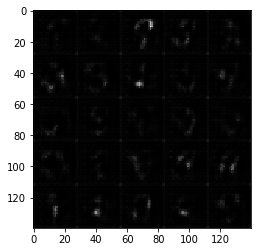

Epoch 1/2 Step 300... Discriminator Loss: 1.0539... Generator Loss: 1.3042
Epoch 1/2 Step 400... Discriminator Loss: 1.1854... Generator Loss: 0.6492


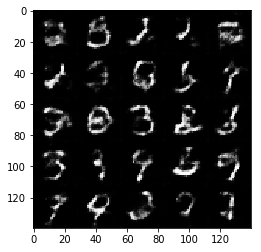

Epoch 1/2 Step 500... Discriminator Loss: 1.0853... Generator Loss: 0.9365
Epoch 1/2 Step 600... Discriminator Loss: 1.4831... Generator Loss: 0.4439


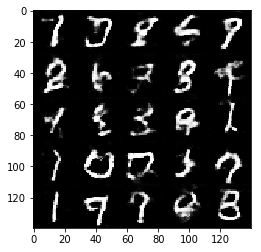

Epoch 1/2 Step 700... Discriminator Loss: 0.9640... Generator Loss: 1.2039
Epoch 1/2 Step 800... Discriminator Loss: 1.1567... Generator Loss: 0.9617


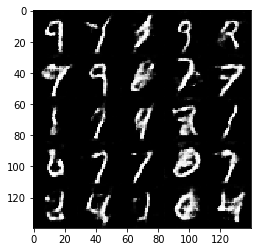

Epoch 1/2 Step 900... Discriminator Loss: 1.4763... Generator Loss: 0.4673
Epoch 1/2 Step 1000... Discriminator Loss: 1.1208... Generator Loss: 1.1435


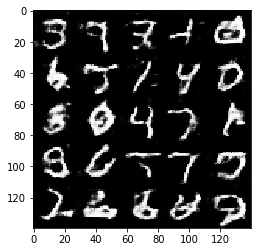

Epoch 1/2 Step 1100... Discriminator Loss: 1.0752... Generator Loss: 2.3685
Epoch 1/2 Step 1200... Discriminator Loss: 0.9756... Generator Loss: 0.9510


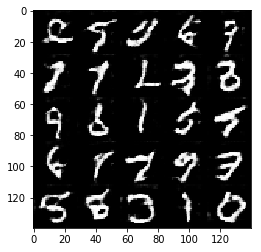

Epoch 1/2 Step 1300... Discriminator Loss: 0.8142... Generator Loss: 1.2012
Epoch 1/2 Step 1400... Discriminator Loss: 0.6037... Generator Loss: 2.1818


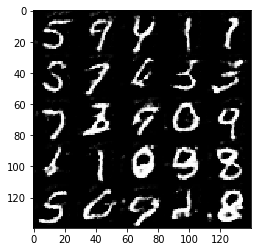

Epoch 1/2 Step 1500... Discriminator Loss: 0.7993... Generator Loss: 1.1612
Epoch 1/2 Step 1600... Discriminator Loss: 0.8606... Generator Loss: 1.0853


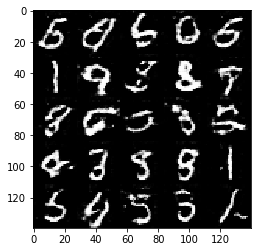

Epoch 1/2 Step 1700... Discriminator Loss: 0.6235... Generator Loss: 1.5984
Epoch 1/2 Step 1800... Discriminator Loss: 0.6983... Generator Loss: 1.4967


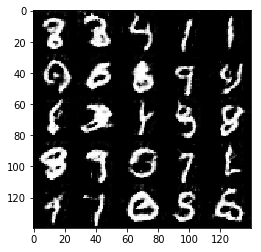

Epoch 2/2 Step 1900... Discriminator Loss: 0.6524... Generator Loss: 2.4214
Epoch 2/2 Step 2000... Discriminator Loss: 1.4174... Generator Loss: 0.4973


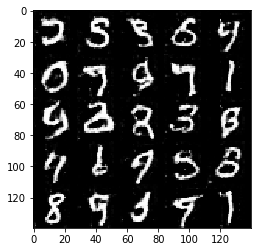

Epoch 2/2 Step 2100... Discriminator Loss: 0.7313... Generator Loss: 1.4036
Epoch 2/2 Step 2200... Discriminator Loss: 0.6343... Generator Loss: 1.7027


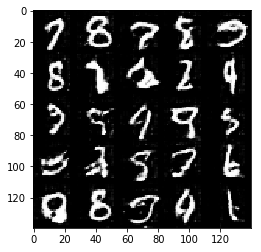

Epoch 2/2 Step 2300... Discriminator Loss: 1.7166... Generator Loss: 3.9200
Epoch 2/2 Step 2400... Discriminator Loss: 0.9315... Generator Loss: 2.5108


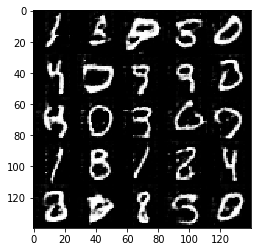

Epoch 2/2 Step 2500... Discriminator Loss: 0.8208... Generator Loss: 1.3551
Epoch 2/2 Step 2600... Discriminator Loss: 0.6220... Generator Loss: 1.8595


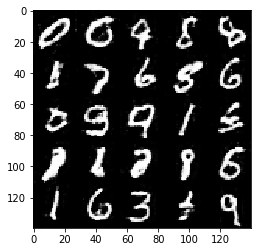

Epoch 2/2 Step 2700... Discriminator Loss: 0.5576... Generator Loss: 1.9791
Epoch 2/2 Step 2800... Discriminator Loss: 0.5978... Generator Loss: 1.8119


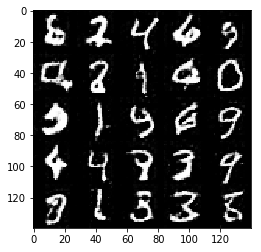

Epoch 2/2 Step 2900... Discriminator Loss: 1.1932... Generator Loss: 0.6904
Epoch 2/2 Step 3000... Discriminator Loss: 0.9988... Generator Loss: 0.8715


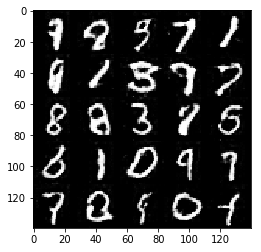

Epoch 2/2 Step 3100... Discriminator Loss: 0.7722... Generator Loss: 1.2368
Epoch 2/2 Step 3200... Discriminator Loss: 0.5827... Generator Loss: 2.0446


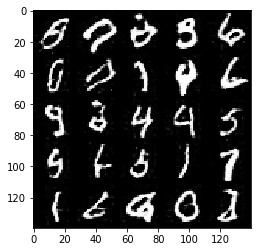

Epoch 2/2 Step 3300... Discriminator Loss: 1.1915... Generator Loss: 0.8081
Epoch 2/2 Step 3400... Discriminator Loss: 0.6780... Generator Loss: 1.4418


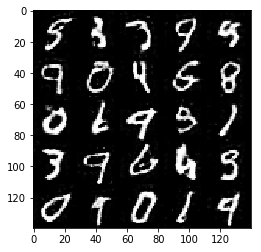

Epoch 2/2 Step 3500... Discriminator Loss: 0.6441... Generator Loss: 1.7720
Epoch 2/2 Step 3600... Discriminator Loss: 0.7938... Generator Loss: 1.2283


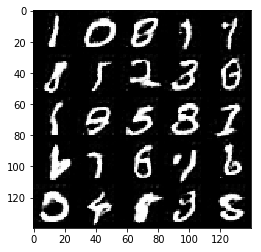

Epoch 2/2 Step 3700... Discriminator Loss: 1.3151... Generator Loss: 0.6164


In [12]:
batch_size = 32
z_dim = 100
learning_rate = 0.0005
beta1 = 0.4


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/10 Step 100... Discriminator Loss: 0.5508... Generator Loss: 7.0601
Epoch 1/10 Step 200... Discriminator Loss: 0.4577... Generator Loss: 2.7008


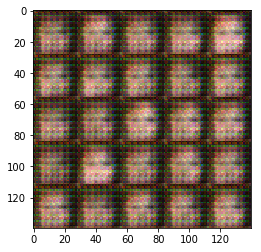

Epoch 1/10 Step 300... Discriminator Loss: 1.0136... Generator Loss: 1.5385
Epoch 1/10 Step 400... Discriminator Loss: 1.0603... Generator Loss: 1.8020


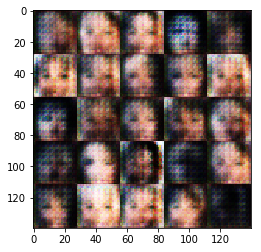

Epoch 1/10 Step 500... Discriminator Loss: 1.2054... Generator Loss: 1.2311
Epoch 1/10 Step 600... Discriminator Loss: 1.4918... Generator Loss: 2.0970


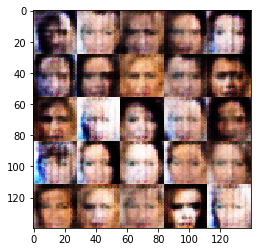

Epoch 1/10 Step 700... Discriminator Loss: 1.2120... Generator Loss: 1.1427
Epoch 1/10 Step 800... Discriminator Loss: 1.3666... Generator Loss: 0.5843


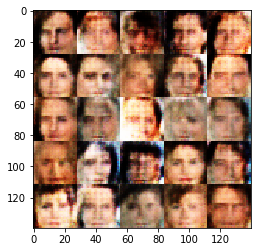

Epoch 1/10 Step 900... Discriminator Loss: 1.2228... Generator Loss: 0.7757
Epoch 1/10 Step 1000... Discriminator Loss: 1.2101... Generator Loss: 0.6972


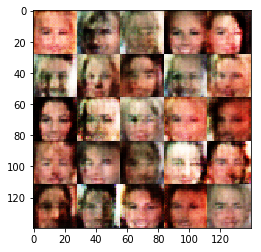

Epoch 1/10 Step 1100... Discriminator Loss: 1.0430... Generator Loss: 1.2774
Epoch 1/10 Step 1200... Discriminator Loss: 1.3864... Generator Loss: 0.6248


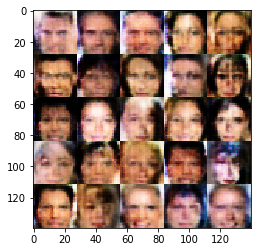

Epoch 1/10 Step 1300... Discriminator Loss: 1.1513... Generator Loss: 1.4142
Epoch 1/10 Step 1400... Discriminator Loss: 1.2858... Generator Loss: 0.7100


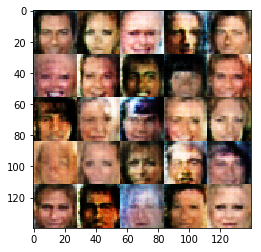

Epoch 1/10 Step 1500... Discriminator Loss: 0.8722... Generator Loss: 1.4316
Epoch 1/10 Step 1600... Discriminator Loss: 1.1147... Generator Loss: 1.8711


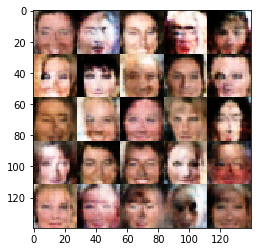

Epoch 1/10 Step 1700... Discriminator Loss: 0.8667... Generator Loss: 2.0605
Epoch 1/10 Step 1800... Discriminator Loss: 1.0333... Generator Loss: 0.9613


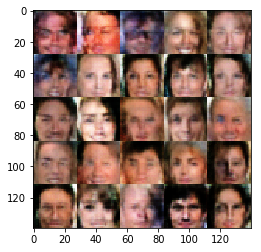

Epoch 1/10 Step 1900... Discriminator Loss: 1.0956... Generator Loss: 2.1954
Epoch 1/10 Step 2000... Discriminator Loss: 0.9599... Generator Loss: 0.9286


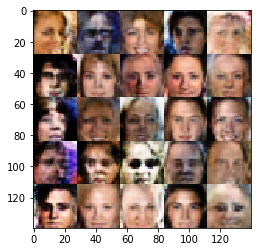

Epoch 1/10 Step 2100... Discriminator Loss: 0.6997... Generator Loss: 1.8918
Epoch 1/10 Step 2200... Discriminator Loss: 0.9862... Generator Loss: 2.0064


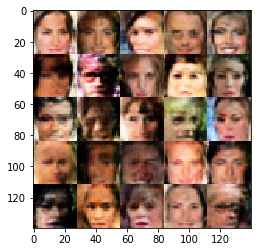

Epoch 1/10 Step 2300... Discriminator Loss: 1.2038... Generator Loss: 0.6697
Epoch 1/10 Step 2400... Discriminator Loss: 1.2156... Generator Loss: 2.3924


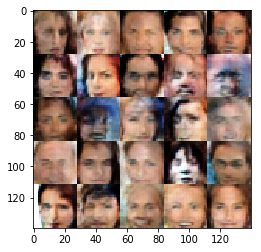

Epoch 1/10 Step 2500... Discriminator Loss: 1.7366... Generator Loss: 0.3136
Epoch 1/10 Step 2600... Discriminator Loss: 1.3992... Generator Loss: 0.4669


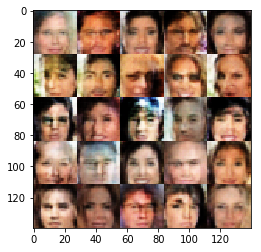

Epoch 1/10 Step 2700... Discriminator Loss: 1.8438... Generator Loss: 0.2934
Epoch 1/10 Step 2800... Discriminator Loss: 0.9926... Generator Loss: 0.9332


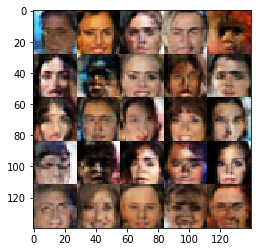

Epoch 1/10 Step 2900... Discriminator Loss: 1.0186... Generator Loss: 1.1217
Epoch 1/10 Step 3000... Discriminator Loss: 1.1480... Generator Loss: 0.6752


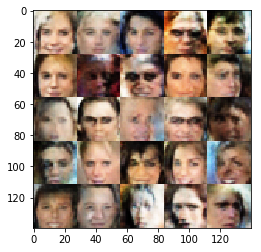

Epoch 1/10 Step 3100... Discriminator Loss: 1.0186... Generator Loss: 0.7984
Epoch 1/10 Step 3200... Discriminator Loss: 1.1681... Generator Loss: 0.7295


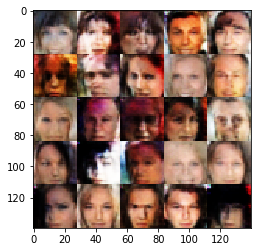

Epoch 1/10 Step 3300... Discriminator Loss: 1.0042... Generator Loss: 2.0496
Epoch 1/10 Step 3400... Discriminator Loss: 1.7526... Generator Loss: 0.3353


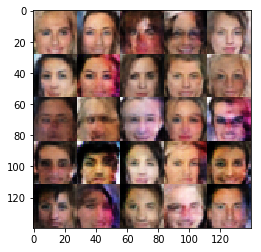

Epoch 1/10 Step 3500... Discriminator Loss: 0.8855... Generator Loss: 1.0969
Epoch 1/10 Step 3600... Discriminator Loss: 1.1085... Generator Loss: 2.7063


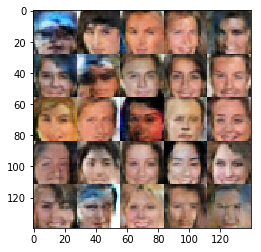

Epoch 1/10 Step 3700... Discriminator Loss: 1.0783... Generator Loss: 0.7879
Epoch 1/10 Step 3800... Discriminator Loss: 1.2457... Generator Loss: 0.5953


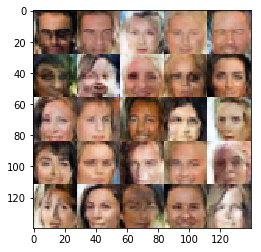

Epoch 1/10 Step 3900... Discriminator Loss: 1.2806... Generator Loss: 0.5822
Epoch 1/10 Step 4000... Discriminator Loss: 0.8366... Generator Loss: 1.7215


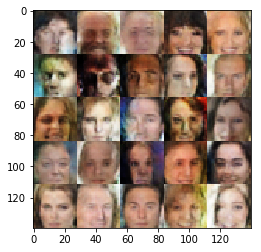

Epoch 1/10 Step 4100... Discriminator Loss: 0.9362... Generator Loss: 1.1474
Epoch 1/10 Step 4200... Discriminator Loss: 0.7885... Generator Loss: 2.5651


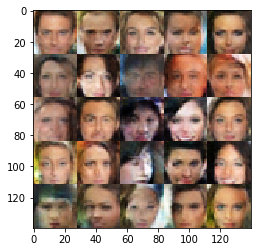

Epoch 1/10 Step 4300... Discriminator Loss: 0.9165... Generator Loss: 1.1818
Epoch 1/10 Step 4400... Discriminator Loss: 0.8083... Generator Loss: 1.2148


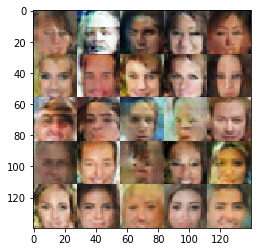

Epoch 1/10 Step 4500... Discriminator Loss: 1.1387... Generator Loss: 1.0017
Epoch 1/10 Step 4600... Discriminator Loss: 1.0629... Generator Loss: 0.7727


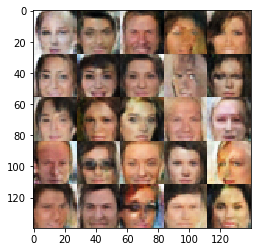

Epoch 1/10 Step 4700... Discriminator Loss: 1.4257... Generator Loss: 2.5666
Epoch 1/10 Step 4800... Discriminator Loss: 1.2324... Generator Loss: 0.6492


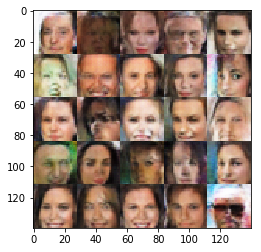

Epoch 1/10 Step 4900... Discriminator Loss: 0.8156... Generator Loss: 1.3645
Epoch 1/10 Step 5000... Discriminator Loss: 0.9881... Generator Loss: 1.4014


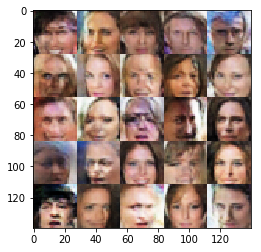

Epoch 1/10 Step 5100... Discriminator Loss: 1.0993... Generator Loss: 0.7654
Epoch 1/10 Step 5200... Discriminator Loss: 0.7938... Generator Loss: 1.5152


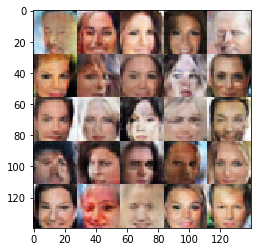

Epoch 1/10 Step 5300... Discriminator Loss: 1.1815... Generator Loss: 1.8593
Epoch 1/10 Step 5400... Discriminator Loss: 0.7452... Generator Loss: 1.7317


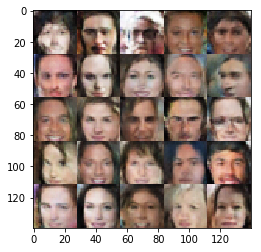

Epoch 1/10 Step 5500... Discriminator Loss: 1.0008... Generator Loss: 1.4854
Epoch 1/10 Step 5600... Discriminator Loss: 1.0199... Generator Loss: 0.8061


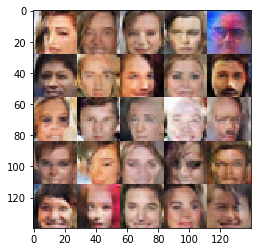

Epoch 1/10 Step 5700... Discriminator Loss: 0.9200... Generator Loss: 0.9779
Epoch 1/10 Step 5800... Discriminator Loss: 0.7393... Generator Loss: 1.4277


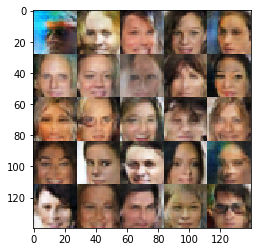

Epoch 1/10 Step 5900... Discriminator Loss: 0.7150... Generator Loss: 1.9072
Epoch 1/10 Step 6000... Discriminator Loss: 2.4225... Generator Loss: 0.1611


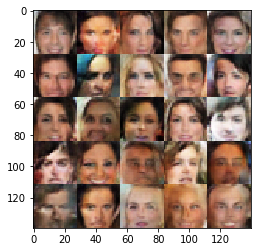

Epoch 1/10 Step 6100... Discriminator Loss: 0.6718... Generator Loss: 1.5304
Epoch 1/10 Step 6200... Discriminator Loss: 1.5115... Generator Loss: 0.4149


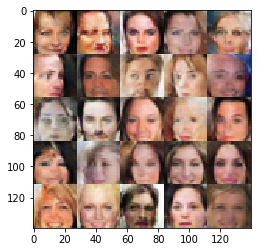

Epoch 1/10 Step 6300... Discriminator Loss: 0.7558... Generator Loss: 1.3566
Epoch 2/10 Step 6400... Discriminator Loss: 1.2750... Generator Loss: 0.5541


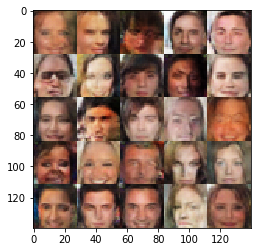

Epoch 2/10 Step 6500... Discriminator Loss: 0.6020... Generator Loss: 2.1158
Epoch 2/10 Step 6600... Discriminator Loss: 1.2420... Generator Loss: 0.6268


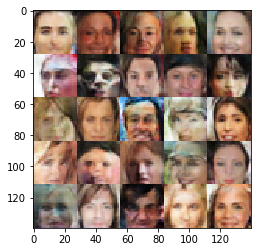

Epoch 2/10 Step 6700... Discriminator Loss: 0.5022... Generator Loss: 2.2380
Epoch 2/10 Step 6800... Discriminator Loss: 1.1169... Generator Loss: 0.7104


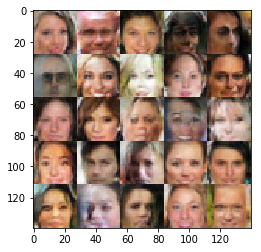

Epoch 2/10 Step 6900... Discriminator Loss: 1.5427... Generator Loss: 0.4669
Epoch 2/10 Step 7000... Discriminator Loss: 0.5858... Generator Loss: 2.6097


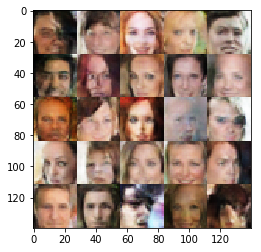

Epoch 2/10 Step 7100... Discriminator Loss: 1.0042... Generator Loss: 2.0741
Epoch 2/10 Step 7200... Discriminator Loss: 0.6982... Generator Loss: 1.4100


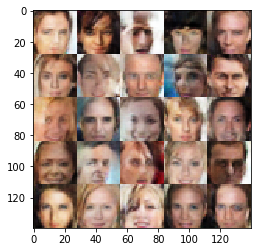

Epoch 2/10 Step 7300... Discriminator Loss: 0.9427... Generator Loss: 2.1337
Epoch 2/10 Step 7400... Discriminator Loss: 0.5244... Generator Loss: 2.0664


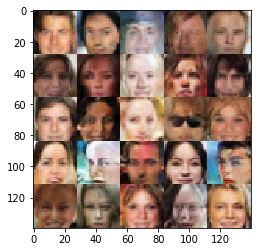

Epoch 2/10 Step 7500... Discriminator Loss: 0.6053... Generator Loss: 2.0848
Epoch 2/10 Step 7600... Discriminator Loss: 0.6151... Generator Loss: 2.0237


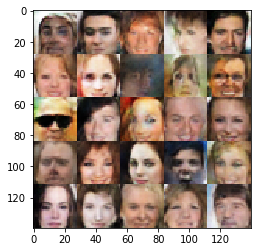

Epoch 2/10 Step 7700... Discriminator Loss: 0.7835... Generator Loss: 1.3177
Epoch 2/10 Step 7800... Discriminator Loss: 0.7367... Generator Loss: 1.7345


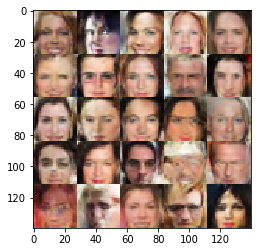

Epoch 2/10 Step 7900... Discriminator Loss: 1.7674... Generator Loss: 0.3905
Epoch 2/10 Step 8000... Discriminator Loss: 0.9153... Generator Loss: 0.9927


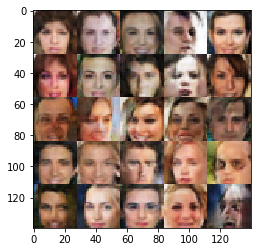

Epoch 2/10 Step 8100... Discriminator Loss: 2.7657... Generator Loss: 0.1706
Epoch 2/10 Step 8200... Discriminator Loss: 0.8528... Generator Loss: 1.0947


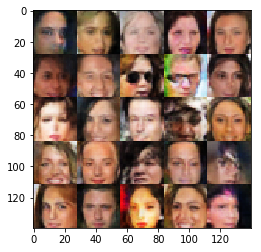

Epoch 2/10 Step 8300... Discriminator Loss: 1.1325... Generator Loss: 0.7750
Epoch 2/10 Step 8400... Discriminator Loss: 1.4761... Generator Loss: 0.4480


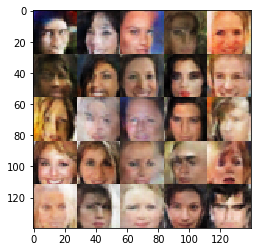

Epoch 2/10 Step 8500... Discriminator Loss: 1.0963... Generator Loss: 0.9058
Epoch 2/10 Step 8600... Discriminator Loss: 0.5214... Generator Loss: 3.3305


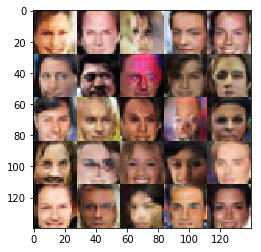

Epoch 2/10 Step 8700... Discriminator Loss: 0.6266... Generator Loss: 1.7400
Epoch 2/10 Step 8800... Discriminator Loss: 0.5167... Generator Loss: 2.2057


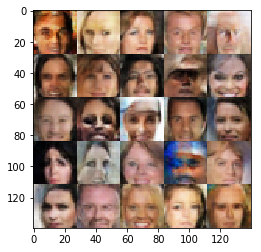

Epoch 2/10 Step 8900... Discriminator Loss: 1.6974... Generator Loss: 0.4233
Epoch 2/10 Step 9000... Discriminator Loss: 0.4543... Generator Loss: 2.4109


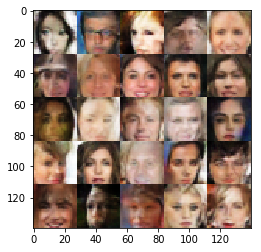

Epoch 2/10 Step 9100... Discriminator Loss: 0.6816... Generator Loss: 1.6164
Epoch 2/10 Step 9200... Discriminator Loss: 0.6521... Generator Loss: 1.7835


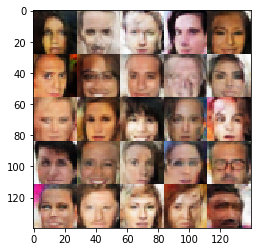

Epoch 2/10 Step 9300... Discriminator Loss: 1.2765... Generator Loss: 0.6206
Epoch 2/10 Step 9400... Discriminator Loss: 0.9190... Generator Loss: 2.0244


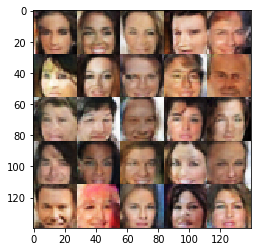

Epoch 2/10 Step 9500... Discriminator Loss: 0.8929... Generator Loss: 0.9979
Epoch 2/10 Step 9600... Discriminator Loss: 1.0247... Generator Loss: 0.8827


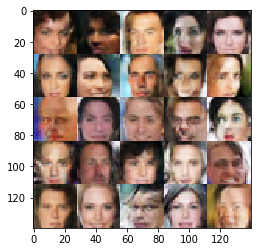

Epoch 2/10 Step 9700... Discriminator Loss: 0.9427... Generator Loss: 0.9926
Epoch 2/10 Step 9800... Discriminator Loss: 1.0750... Generator Loss: 0.8246


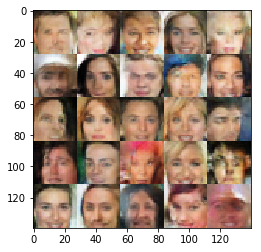

Epoch 2/10 Step 9900... Discriminator Loss: 0.7138... Generator Loss: 1.4448
Epoch 2/10 Step 10000... Discriminator Loss: 0.5853... Generator Loss: 2.1111


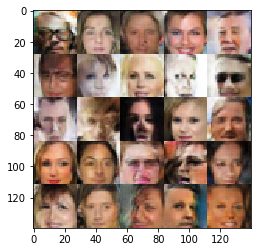

Epoch 2/10 Step 10100... Discriminator Loss: 1.1309... Generator Loss: 0.7508
Epoch 2/10 Step 10200... Discriminator Loss: 0.6411... Generator Loss: 2.1449


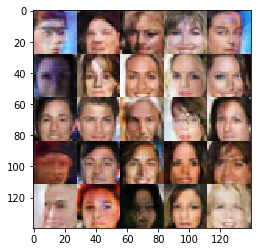

Epoch 2/10 Step 10300... Discriminator Loss: 0.6384... Generator Loss: 1.6401
Epoch 2/10 Step 10400... Discriminator Loss: 0.5178... Generator Loss: 2.1742


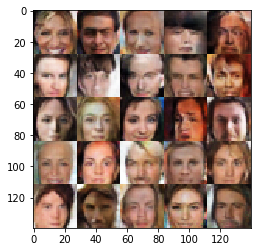

Epoch 2/10 Step 10500... Discriminator Loss: 0.6904... Generator Loss: 1.4352
Epoch 2/10 Step 10600... Discriminator Loss: 2.6103... Generator Loss: 0.1580


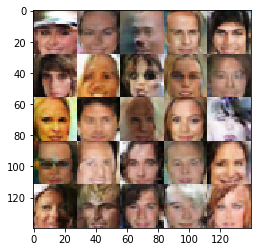

Epoch 2/10 Step 10700... Discriminator Loss: 2.1033... Generator Loss: 0.2583
Epoch 2/10 Step 10800... Discriminator Loss: 0.7147... Generator Loss: 1.3916


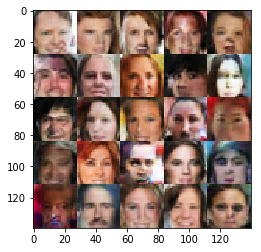

Epoch 2/10 Step 10900... Discriminator Loss: 0.6350... Generator Loss: 1.9669
Epoch 2/10 Step 11000... Discriminator Loss: 2.5445... Generator Loss: 0.1673


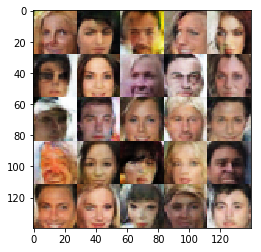

Epoch 2/10 Step 11100... Discriminator Loss: 0.5412... Generator Loss: 1.9408
Epoch 2/10 Step 11200... Discriminator Loss: 0.6367... Generator Loss: 1.9094


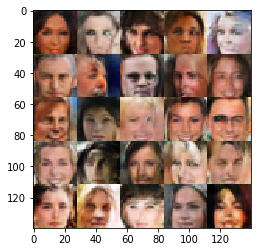

Epoch 2/10 Step 11300... Discriminator Loss: 1.0422... Generator Loss: 0.8982
Epoch 2/10 Step 11400... Discriminator Loss: 0.6333... Generator Loss: 1.7296


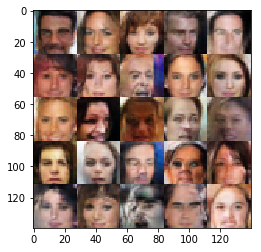

Epoch 2/10 Step 11500... Discriminator Loss: 0.5113... Generator Loss: 2.9610
Epoch 2/10 Step 11600... Discriminator Loss: 0.5549... Generator Loss: 3.1148


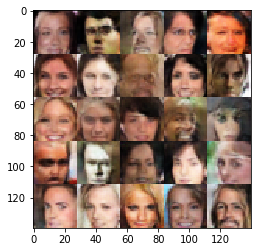

Epoch 2/10 Step 11700... Discriminator Loss: 0.5707... Generator Loss: 2.0740
Epoch 2/10 Step 11800... Discriminator Loss: 1.7882... Generator Loss: 0.4363


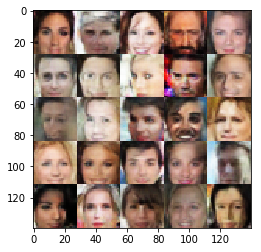

Epoch 2/10 Step 11900... Discriminator Loss: 1.4091... Generator Loss: 0.6279
Epoch 2/10 Step 12000... Discriminator Loss: 1.1824... Generator Loss: 0.7140


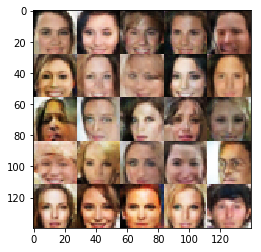

Epoch 2/10 Step 12100... Discriminator Loss: 0.8615... Generator Loss: 1.5754
Epoch 2/10 Step 12200... Discriminator Loss: 0.5682... Generator Loss: 2.0170


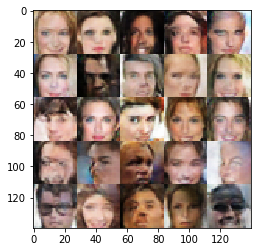

Epoch 2/10 Step 12300... Discriminator Loss: 0.6546... Generator Loss: 1.4350
Epoch 2/10 Step 12400... Discriminator Loss: 0.9451... Generator Loss: 0.9446


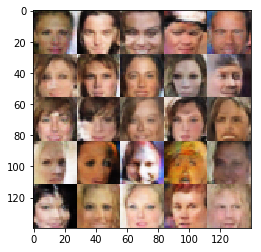

Epoch 2/10 Step 12500... Discriminator Loss: 0.8615... Generator Loss: 1.1906
Epoch 2/10 Step 12600... Discriminator Loss: 0.9173... Generator Loss: 2.3105


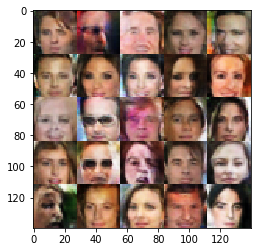

Epoch 3/10 Step 12700... Discriminator Loss: 0.4413... Generator Loss: 3.1574
Epoch 3/10 Step 12800... Discriminator Loss: 0.7018... Generator Loss: 2.0061


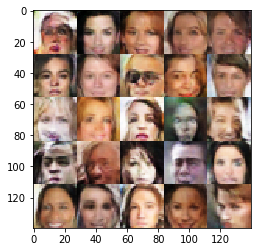

Epoch 3/10 Step 12900... Discriminator Loss: 1.0705... Generator Loss: 0.8148
Epoch 3/10 Step 13000... Discriminator Loss: 0.9126... Generator Loss: 0.9842


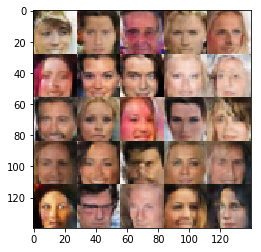

Epoch 3/10 Step 13100... Discriminator Loss: 1.1094... Generator Loss: 0.8605
Epoch 3/10 Step 13200... Discriminator Loss: 0.8642... Generator Loss: 1.0882


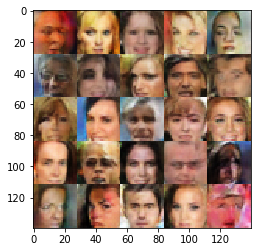

Epoch 3/10 Step 13300... Discriminator Loss: 0.6310... Generator Loss: 1.6543
Epoch 3/10 Step 13400... Discriminator Loss: 0.7322... Generator Loss: 1.6138


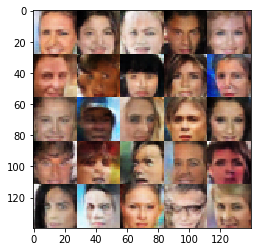

Epoch 3/10 Step 13500... Discriminator Loss: 1.0281... Generator Loss: 0.8647
Epoch 3/10 Step 13600... Discriminator Loss: 0.5706... Generator Loss: 3.3761


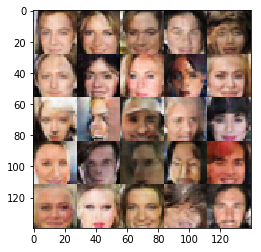

Epoch 3/10 Step 13700... Discriminator Loss: 0.8025... Generator Loss: 1.2364
Epoch 3/10 Step 13800... Discriminator Loss: 0.6704... Generator Loss: 1.5403


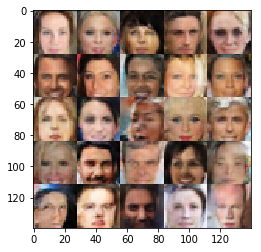

Epoch 3/10 Step 13900... Discriminator Loss: 0.8509... Generator Loss: 1.2843
Epoch 3/10 Step 14000... Discriminator Loss: 1.4931... Generator Loss: 0.4796


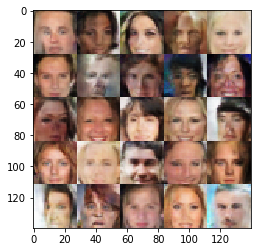

Epoch 3/10 Step 14100... Discriminator Loss: 0.5749... Generator Loss: 1.8729
Epoch 3/10 Step 14200... Discriminator Loss: 0.5900... Generator Loss: 1.8325


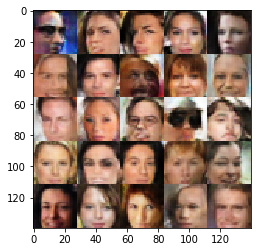

Epoch 3/10 Step 14300... Discriminator Loss: 0.6969... Generator Loss: 1.5776
Epoch 3/10 Step 14400... Discriminator Loss: 1.4023... Generator Loss: 0.7652


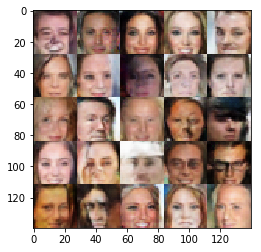

Epoch 3/10 Step 14500... Discriminator Loss: 1.0335... Generator Loss: 0.9053
Epoch 3/10 Step 14600... Discriminator Loss: 0.9962... Generator Loss: 0.9537


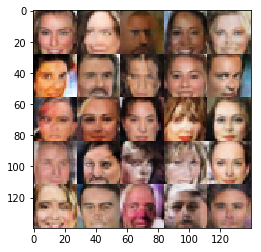

Epoch 3/10 Step 14700... Discriminator Loss: 1.6368... Generator Loss: 0.3965
Epoch 3/10 Step 14800... Discriminator Loss: 0.7651... Generator Loss: 1.3796


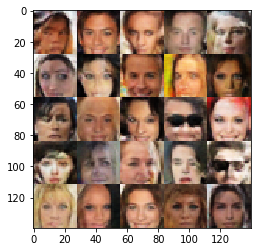

Epoch 3/10 Step 14900... Discriminator Loss: 0.6417... Generator Loss: 2.2617
Epoch 3/10 Step 15000... Discriminator Loss: 0.4765... Generator Loss: 2.3979


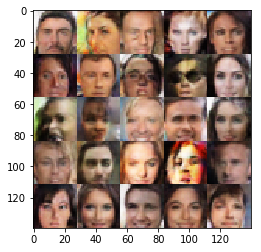

Epoch 3/10 Step 15100... Discriminator Loss: 0.7194... Generator Loss: 2.0074
Epoch 3/10 Step 15200... Discriminator Loss: 0.7010... Generator Loss: 2.2029


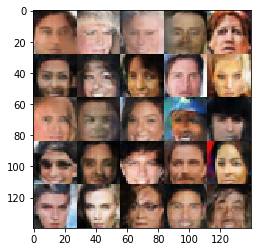

Epoch 3/10 Step 15300... Discriminator Loss: 0.8866... Generator Loss: 1.2235
Epoch 3/10 Step 15400... Discriminator Loss: 0.9851... Generator Loss: 0.8927


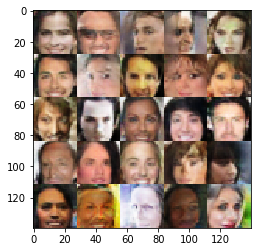

Epoch 3/10 Step 15500... Discriminator Loss: 0.6550... Generator Loss: 3.1663
Epoch 3/10 Step 15600... Discriminator Loss: 0.7961... Generator Loss: 1.2534


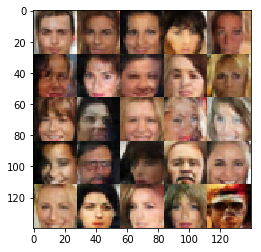

Epoch 3/10 Step 15700... Discriminator Loss: 0.5948... Generator Loss: 1.8677
Epoch 3/10 Step 15800... Discriminator Loss: 0.5338... Generator Loss: 2.0986


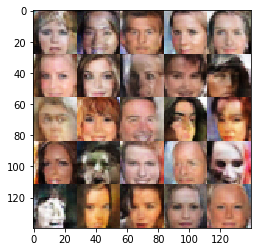

Epoch 3/10 Step 15900... Discriminator Loss: 2.2692... Generator Loss: 0.2658
Epoch 3/10 Step 16000... Discriminator Loss: 2.0842... Generator Loss: 0.2815


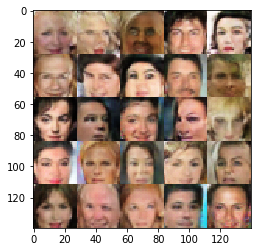

Epoch 3/10 Step 16100... Discriminator Loss: 1.4982... Generator Loss: 2.6300
Epoch 3/10 Step 16200... Discriminator Loss: 0.7870... Generator Loss: 1.1949


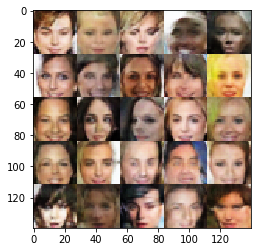

Epoch 3/10 Step 16300... Discriminator Loss: 0.8641... Generator Loss: 1.0935
Epoch 3/10 Step 16400... Discriminator Loss: 0.5458... Generator Loss: 3.6143


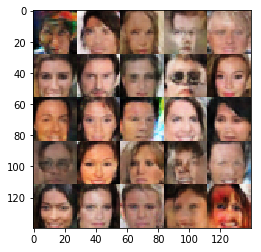

Epoch 3/10 Step 16500... Discriminator Loss: 1.0213... Generator Loss: 0.9285
Epoch 3/10 Step 16600... Discriminator Loss: 0.8172... Generator Loss: 1.2569


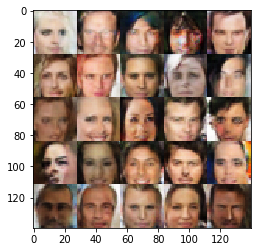

Epoch 3/10 Step 16700... Discriminator Loss: 1.0516... Generator Loss: 0.8734
Epoch 3/10 Step 16800... Discriminator Loss: 1.1308... Generator Loss: 0.7875


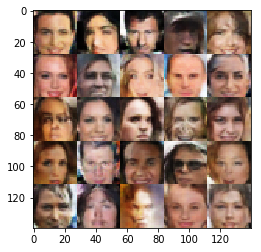

Epoch 3/10 Step 16900... Discriminator Loss: 0.7825... Generator Loss: 1.3194
Epoch 3/10 Step 17000... Discriminator Loss: 0.7654... Generator Loss: 1.2109


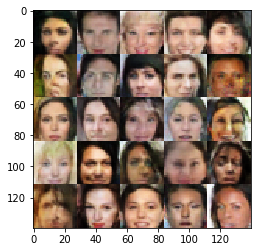

Epoch 3/10 Step 17100... Discriminator Loss: 1.3479... Generator Loss: 0.6543
Epoch 3/10 Step 17200... Discriminator Loss: 1.0244... Generator Loss: 0.9826


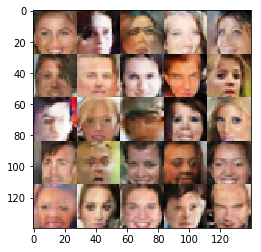

Epoch 3/10 Step 17300... Discriminator Loss: 0.4130... Generator Loss: 4.2627
Epoch 3/10 Step 17400... Discriminator Loss: 0.5488... Generator Loss: 1.9754


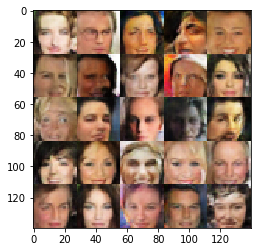

Epoch 3/10 Step 17500... Discriminator Loss: 0.6203... Generator Loss: 4.1646
Epoch 3/10 Step 17600... Discriminator Loss: 0.6441... Generator Loss: 1.7855


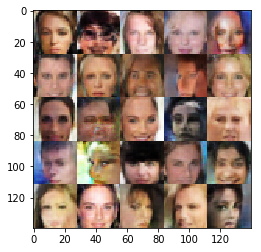

Epoch 3/10 Step 17700... Discriminator Loss: 0.9673... Generator Loss: 2.3632
Epoch 3/10 Step 17800... Discriminator Loss: 0.7212... Generator Loss: 1.3394


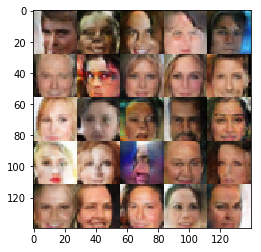

Epoch 3/10 Step 17900... Discriminator Loss: 2.3009... Generator Loss: 0.2402
Epoch 3/10 Step 18000... Discriminator Loss: 0.6778... Generator Loss: 1.9008


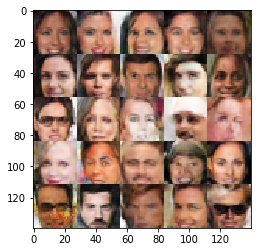

Epoch 3/10 Step 18100... Discriminator Loss: 1.6306... Generator Loss: 0.4495
Epoch 3/10 Step 18200... Discriminator Loss: 1.0846... Generator Loss: 0.7790


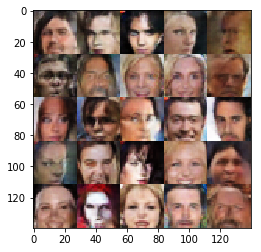

Epoch 3/10 Step 18300... Discriminator Loss: 0.6384... Generator Loss: 1.6107
Epoch 3/10 Step 18400... Discriminator Loss: 0.7791... Generator Loss: 1.2902


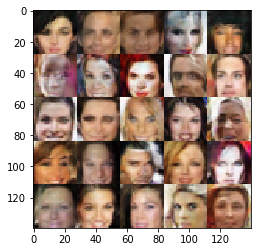

Epoch 3/10 Step 18500... Discriminator Loss: 0.7708... Generator Loss: 1.2977
Epoch 3/10 Step 18600... Discriminator Loss: 1.2390... Generator Loss: 0.7546


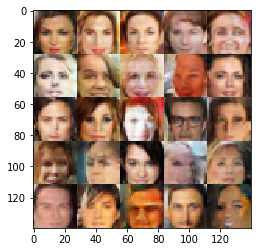

Epoch 3/10 Step 18700... Discriminator Loss: 0.8885... Generator Loss: 1.0962
Epoch 3/10 Step 18800... Discriminator Loss: 0.4707... Generator Loss: 2.4204


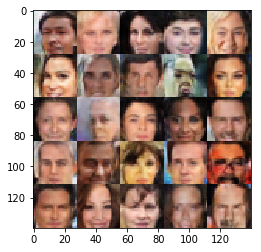

Epoch 3/10 Step 18900... Discriminator Loss: 1.6594... Generator Loss: 0.4247
Epoch 4/10 Step 19000... Discriminator Loss: 1.0160... Generator Loss: 1.1570


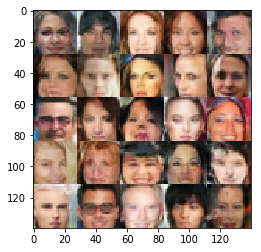

Epoch 4/10 Step 19100... Discriminator Loss: 0.7324... Generator Loss: 2.1688
Epoch 4/10 Step 19200... Discriminator Loss: 0.6878... Generator Loss: 1.5080


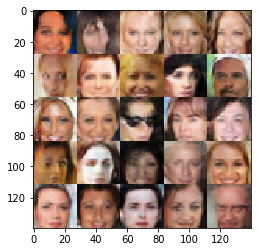

Epoch 4/10 Step 19300... Discriminator Loss: 1.9089... Generator Loss: 0.3153
Epoch 4/10 Step 19400... Discriminator Loss: 1.1893... Generator Loss: 0.7737


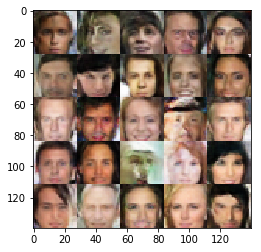

Epoch 4/10 Step 19500... Discriminator Loss: 0.7806... Generator Loss: 1.2565
Epoch 4/10 Step 19600... Discriminator Loss: 0.7718... Generator Loss: 2.5234


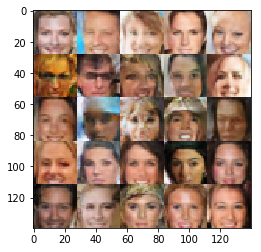

Epoch 4/10 Step 19700... Discriminator Loss: 0.7480... Generator Loss: 1.3818
Epoch 4/10 Step 19800... Discriminator Loss: 1.1217... Generator Loss: 2.8084


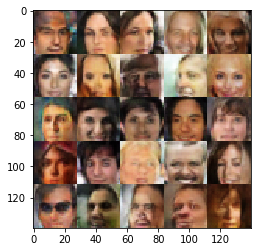

Epoch 4/10 Step 19900... Discriminator Loss: 0.6521... Generator Loss: 1.6325
Epoch 4/10 Step 20000... Discriminator Loss: 0.6422... Generator Loss: 1.7367


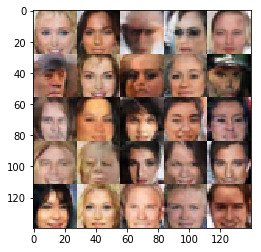

Epoch 4/10 Step 20100... Discriminator Loss: 0.5566... Generator Loss: 1.9759
Epoch 4/10 Step 20200... Discriminator Loss: 0.6248... Generator Loss: 2.9273


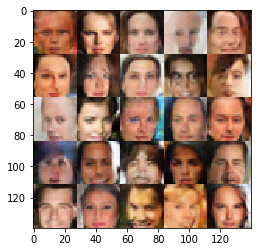

Epoch 4/10 Step 20300... Discriminator Loss: 1.8587... Generator Loss: 0.3553
Epoch 4/10 Step 20400... Discriminator Loss: 0.6608... Generator Loss: 1.5042


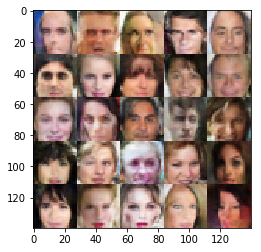

Epoch 4/10 Step 20500... Discriminator Loss: 0.8736... Generator Loss: 1.1594
Epoch 4/10 Step 20600... Discriminator Loss: 0.8661... Generator Loss: 1.3285


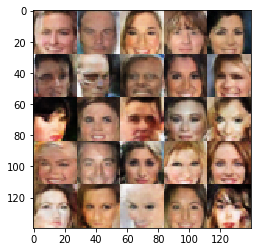

Epoch 4/10 Step 20700... Discriminator Loss: 1.1506... Generator Loss: 0.8223
Epoch 4/10 Step 20800... Discriminator Loss: 1.0272... Generator Loss: 0.8119


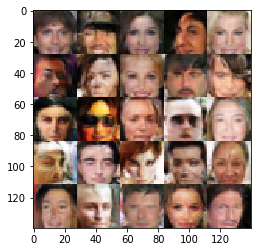

Epoch 4/10 Step 20900... Discriminator Loss: 0.9236... Generator Loss: 1.0414
Epoch 4/10 Step 21000... Discriminator Loss: 0.8101... Generator Loss: 1.2243


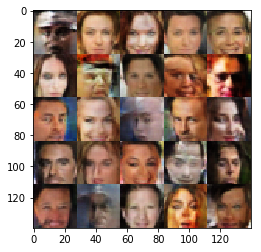

Epoch 4/10 Step 21100... Discriminator Loss: 0.5280... Generator Loss: 3.2007
Epoch 4/10 Step 21200... Discriminator Loss: 0.7598... Generator Loss: 1.3332


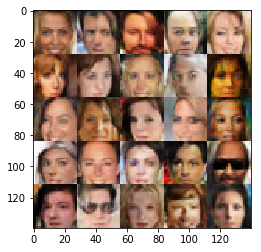

Epoch 4/10 Step 21300... Discriminator Loss: 0.9257... Generator Loss: 1.0509
Epoch 4/10 Step 21400... Discriminator Loss: 1.8285... Generator Loss: 0.3481


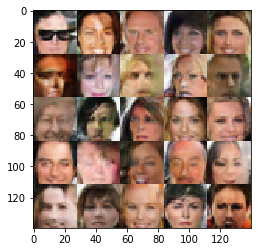

Epoch 4/10 Step 21500... Discriminator Loss: 0.6663... Generator Loss: 1.4724
Epoch 4/10 Step 21600... Discriminator Loss: 0.6208... Generator Loss: 2.1062


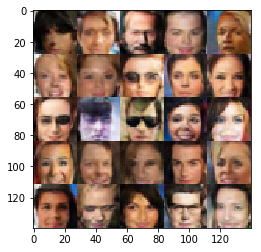

Epoch 4/10 Step 21700... Discriminator Loss: 0.7557... Generator Loss: 1.3548
Epoch 4/10 Step 21800... Discriminator Loss: 0.6972... Generator Loss: 1.5650


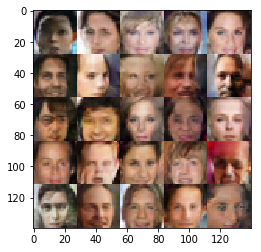

Epoch 4/10 Step 21900... Discriminator Loss: 1.1065... Generator Loss: 0.8182
Epoch 4/10 Step 22000... Discriminator Loss: 0.7876... Generator Loss: 1.2661


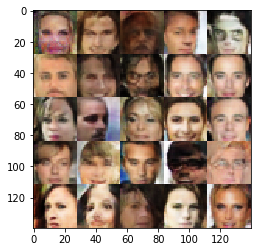

Epoch 4/10 Step 22100... Discriminator Loss: 0.5485... Generator Loss: 2.0626
Epoch 4/10 Step 22200... Discriminator Loss: 0.6595... Generator Loss: 1.6319


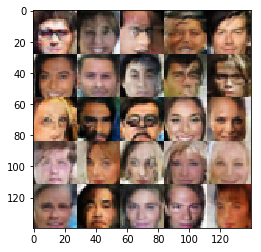

Epoch 4/10 Step 22300... Discriminator Loss: 1.2208... Generator Loss: 0.7111
Epoch 4/10 Step 22400... Discriminator Loss: 1.0254... Generator Loss: 0.8964


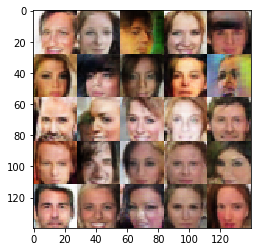

Epoch 4/10 Step 22500... Discriminator Loss: 0.7839... Generator Loss: 1.2282
Epoch 4/10 Step 22600... Discriminator Loss: 0.7172... Generator Loss: 1.6063


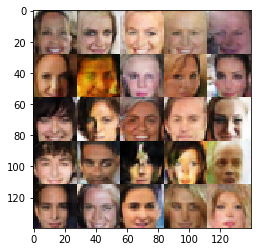

Epoch 4/10 Step 22700... Discriminator Loss: 0.6369... Generator Loss: 1.8069
Epoch 4/10 Step 22800... Discriminator Loss: 1.1782... Generator Loss: 0.7077


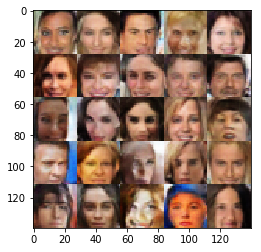

Epoch 4/10 Step 22900... Discriminator Loss: 1.1389... Generator Loss: 0.7774
Epoch 4/10 Step 23000... Discriminator Loss: 0.9316... Generator Loss: 1.0527


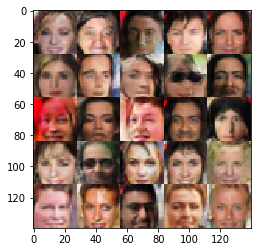

Epoch 4/10 Step 23100... Discriminator Loss: 0.8866... Generator Loss: 2.5985
Epoch 4/10 Step 23200... Discriminator Loss: 0.9765... Generator Loss: 0.9584


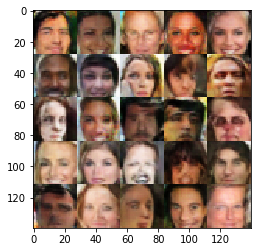

Epoch 4/10 Step 23300... Discriminator Loss: 0.4817... Generator Loss: 3.0097
Epoch 4/10 Step 23400... Discriminator Loss: 1.7193... Generator Loss: 0.4670


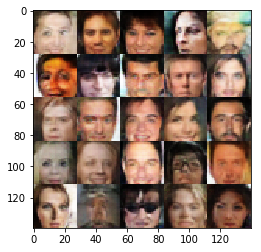

Epoch 4/10 Step 23500... Discriminator Loss: 0.7753... Generator Loss: 1.2391
Epoch 4/10 Step 23600... Discriminator Loss: 1.3763... Generator Loss: 0.5973


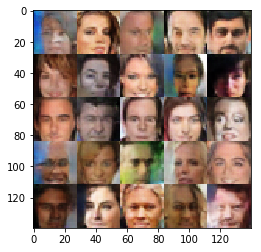

Epoch 4/10 Step 23700... Discriminator Loss: 0.6625... Generator Loss: 1.6558
Epoch 4/10 Step 23800... Discriminator Loss: 0.6846... Generator Loss: 1.5633


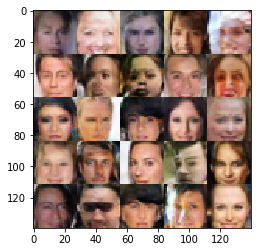

Epoch 4/10 Step 23900... Discriminator Loss: 0.9853... Generator Loss: 0.9320
Epoch 4/10 Step 24000... Discriminator Loss: 0.6491... Generator Loss: 2.2354


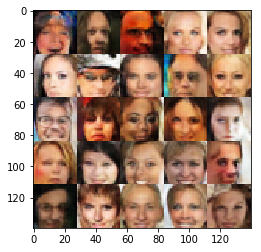

Epoch 4/10 Step 24100... Discriminator Loss: 0.9971... Generator Loss: 0.9465
Epoch 4/10 Step 24200... Discriminator Loss: 0.7139... Generator Loss: 1.3180


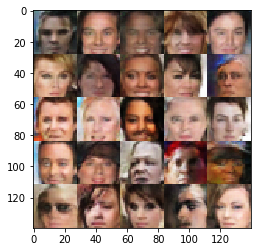

Epoch 4/10 Step 24300... Discriminator Loss: 0.9680... Generator Loss: 1.0272
Epoch 4/10 Step 24400... Discriminator Loss: 0.8617... Generator Loss: 1.3350


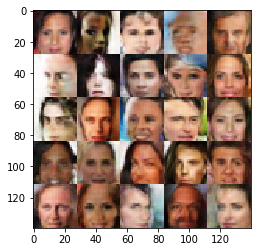

Epoch 4/10 Step 24500... Discriminator Loss: 0.7463... Generator Loss: 1.4563
Epoch 4/10 Step 24600... Discriminator Loss: 0.9428... Generator Loss: 1.1080


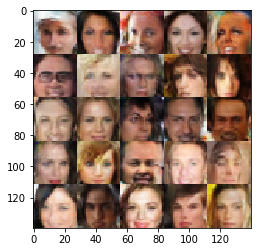

Epoch 4/10 Step 24700... Discriminator Loss: 2.2907... Generator Loss: 4.4098
Epoch 4/10 Step 24800... Discriminator Loss: 0.6136... Generator Loss: 1.9882


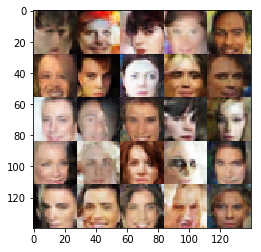

Epoch 4/10 Step 24900... Discriminator Loss: 0.7630... Generator Loss: 1.3480
Epoch 4/10 Step 25000... Discriminator Loss: 0.6507... Generator Loss: 1.6956


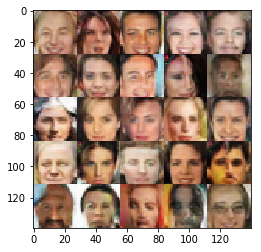

Epoch 4/10 Step 25100... Discriminator Loss: 1.6038... Generator Loss: 0.4904
Epoch 4/10 Step 25200... Discriminator Loss: 0.8810... Generator Loss: 0.9750


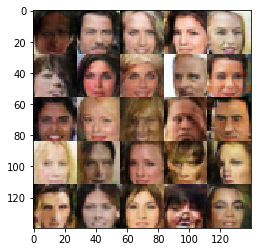

Epoch 4/10 Step 25300... Discriminator Loss: 1.7117... Generator Loss: 0.4423
Epoch 5/10 Step 25400... Discriminator Loss: 0.5819... Generator Loss: 2.6755


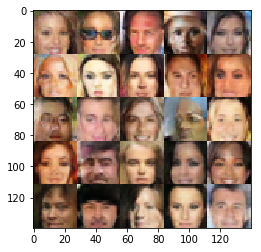

Epoch 5/10 Step 25500... Discriminator Loss: 1.6717... Generator Loss: 0.4352
Epoch 5/10 Step 25600... Discriminator Loss: 0.6620... Generator Loss: 2.2970


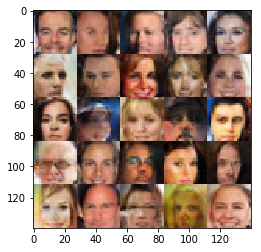

Epoch 5/10 Step 25700... Discriminator Loss: 0.9690... Generator Loss: 0.9676
Epoch 5/10 Step 25800... Discriminator Loss: 0.8050... Generator Loss: 1.3325


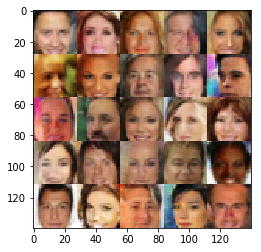

Epoch 5/10 Step 25900... Discriminator Loss: 0.8495... Generator Loss: 1.1453
Epoch 5/10 Step 26000... Discriminator Loss: 0.9354... Generator Loss: 1.0120


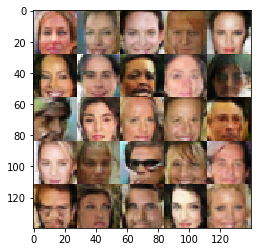

Epoch 5/10 Step 26100... Discriminator Loss: 1.2722... Generator Loss: 0.6192
Epoch 5/10 Step 26200... Discriminator Loss: 0.6670... Generator Loss: 1.7601


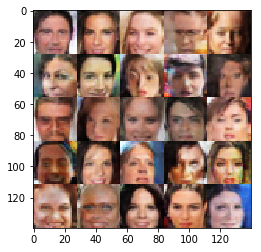

Epoch 5/10 Step 26300... Discriminator Loss: 0.5147... Generator Loss: 2.1190
Epoch 5/10 Step 26400... Discriminator Loss: 0.9714... Generator Loss: 0.9582


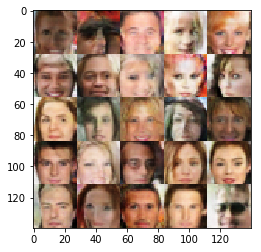

Epoch 5/10 Step 26500... Discriminator Loss: 1.2894... Generator Loss: 0.5951
Epoch 5/10 Step 26600... Discriminator Loss: 0.8255... Generator Loss: 1.1928


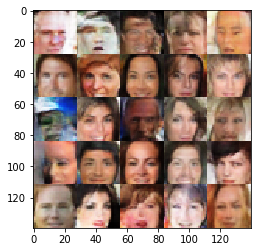

Epoch 5/10 Step 26700... Discriminator Loss: 2.5476... Generator Loss: 0.1762
Epoch 5/10 Step 26800... Discriminator Loss: 0.6811... Generator Loss: 2.5008


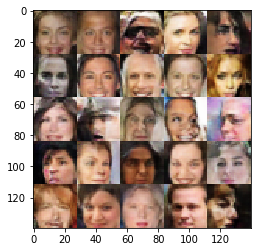

Epoch 5/10 Step 26900... Discriminator Loss: 1.1307... Generator Loss: 0.8172
Epoch 5/10 Step 27000... Discriminator Loss: 1.2673... Generator Loss: 0.7213


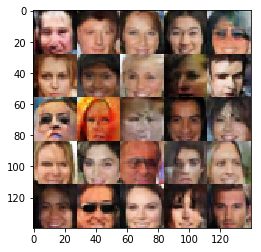

Epoch 5/10 Step 27100... Discriminator Loss: 1.0037... Generator Loss: 0.8986
Epoch 5/10 Step 27200... Discriminator Loss: 1.0414... Generator Loss: 0.8937


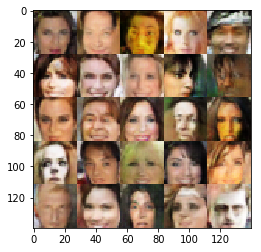

Epoch 5/10 Step 27300... Discriminator Loss: 0.7262... Generator Loss: 1.3467
Epoch 5/10 Step 27400... Discriminator Loss: 0.7022... Generator Loss: 1.7161


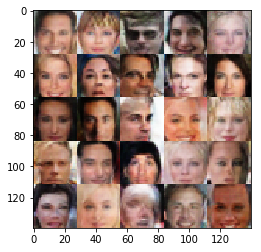

Epoch 5/10 Step 27500... Discriminator Loss: 0.9463... Generator Loss: 1.0036
Epoch 5/10 Step 27600... Discriminator Loss: 0.8659... Generator Loss: 1.1765


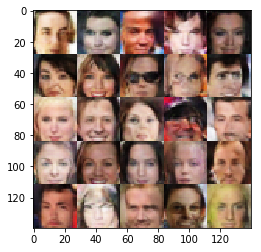

Epoch 5/10 Step 27700... Discriminator Loss: 1.1706... Generator Loss: 0.7834
Epoch 5/10 Step 27800... Discriminator Loss: 0.6666... Generator Loss: 2.1490


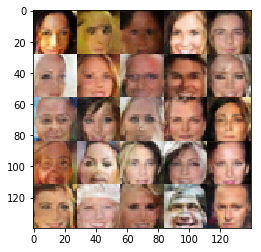

Epoch 5/10 Step 27900... Discriminator Loss: 1.7581... Generator Loss: 0.4832
Epoch 5/10 Step 28000... Discriminator Loss: 1.2452... Generator Loss: 0.7261


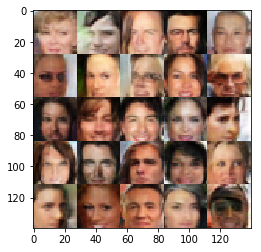

Epoch 5/10 Step 28100... Discriminator Loss: 1.0245... Generator Loss: 0.8364
Epoch 5/10 Step 28200... Discriminator Loss: 1.3151... Generator Loss: 0.6979


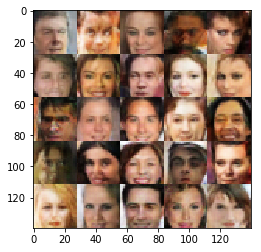

Epoch 5/10 Step 28300... Discriminator Loss: 2.5145... Generator Loss: 0.1848
Epoch 5/10 Step 28400... Discriminator Loss: 1.0414... Generator Loss: 0.8721


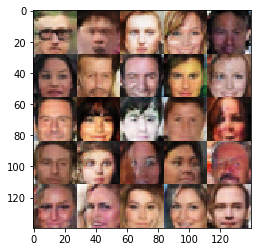

Epoch 5/10 Step 28500... Discriminator Loss: 0.9259... Generator Loss: 1.0033
Epoch 5/10 Step 28600... Discriminator Loss: 2.4220... Generator Loss: 0.2145


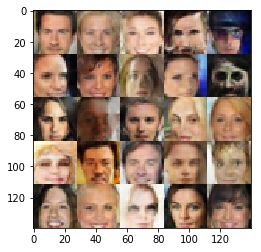

Epoch 5/10 Step 28700... Discriminator Loss: 0.5388... Generator Loss: 4.5170
Epoch 5/10 Step 28800... Discriminator Loss: 0.7112... Generator Loss: 1.4634


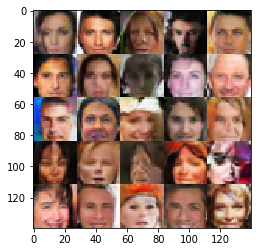

Epoch 5/10 Step 28900... Discriminator Loss: 0.6303... Generator Loss: 1.8189
Epoch 5/10 Step 29000... Discriminator Loss: 2.3978... Generator Loss: 0.2181


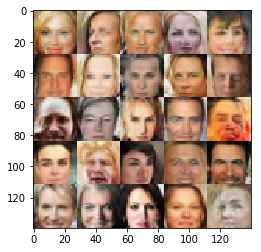

Epoch 5/10 Step 29100... Discriminator Loss: 1.1956... Generator Loss: 0.6567
Epoch 5/10 Step 29200... Discriminator Loss: 0.4464... Generator Loss: 3.1697


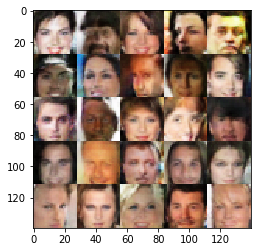

Epoch 5/10 Step 29300... Discriminator Loss: 2.3647... Generator Loss: 0.2164
Epoch 5/10 Step 29400... Discriminator Loss: 0.7009... Generator Loss: 1.4510


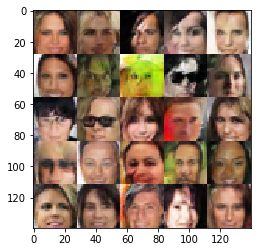

Epoch 5/10 Step 29500... Discriminator Loss: 0.5608... Generator Loss: 2.2809
Epoch 5/10 Step 29600... Discriminator Loss: 0.6637... Generator Loss: 1.7119


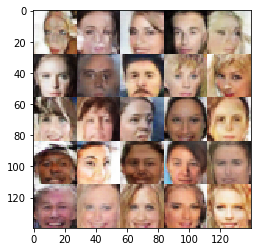

Epoch 5/10 Step 29700... Discriminator Loss: 0.8900... Generator Loss: 1.0406
Epoch 5/10 Step 29800... Discriminator Loss: 1.0082... Generator Loss: 0.9469


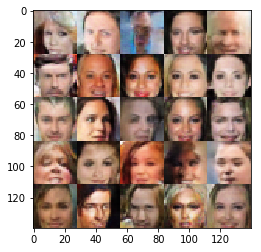

Epoch 5/10 Step 29900... Discriminator Loss: 0.8281... Generator Loss: 1.1953
Epoch 5/10 Step 30000... Discriminator Loss: 0.6314... Generator Loss: 1.8019


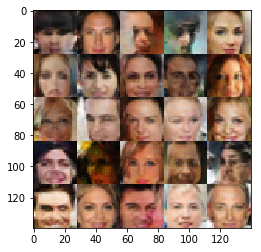

Epoch 5/10 Step 30100... Discriminator Loss: 1.3909... Generator Loss: 0.6184
Epoch 5/10 Step 30200... Discriminator Loss: 0.9945... Generator Loss: 0.9419


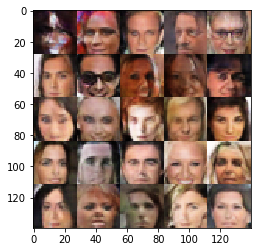

Epoch 5/10 Step 30300... Discriminator Loss: 0.9865... Generator Loss: 0.9735
Epoch 5/10 Step 30400... Discriminator Loss: 0.7438... Generator Loss: 1.5048


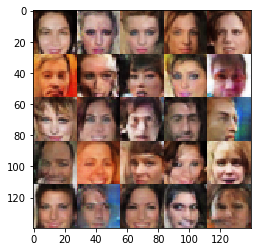

Epoch 5/10 Step 30500... Discriminator Loss: 1.4912... Generator Loss: 0.6578
Epoch 5/10 Step 30600... Discriminator Loss: 0.6997... Generator Loss: 1.4323


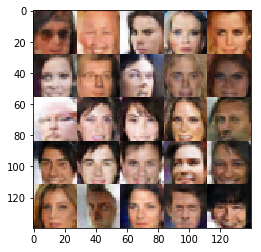

Epoch 5/10 Step 30700... Discriminator Loss: 0.7351... Generator Loss: 1.5189
Epoch 5/10 Step 30800... Discriminator Loss: 1.4168... Generator Loss: 0.6538


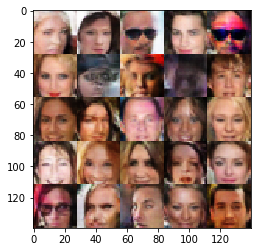

Epoch 5/10 Step 30900... Discriminator Loss: 0.9628... Generator Loss: 1.0039
Epoch 5/10 Step 31000... Discriminator Loss: 1.0626... Generator Loss: 0.7580


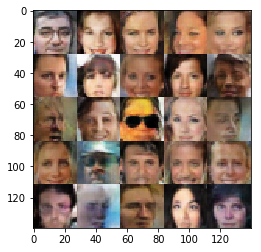

Epoch 5/10 Step 31100... Discriminator Loss: 0.9597... Generator Loss: 0.9917
Epoch 5/10 Step 31200... Discriminator Loss: 0.6394... Generator Loss: 1.9972


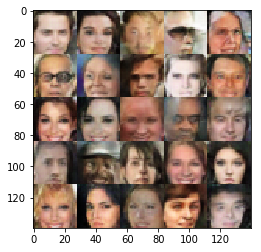

Epoch 5/10 Step 31300... Discriminator Loss: 0.7976... Generator Loss: 1.2736
Epoch 5/10 Step 31400... Discriminator Loss: 0.5550... Generator Loss: 2.2617


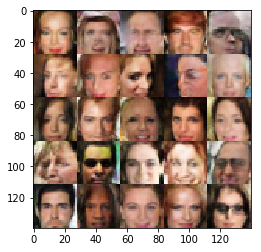

Epoch 5/10 Step 31500... Discriminator Loss: 1.2221... Generator Loss: 0.7101
Epoch 5/10 Step 31600... Discriminator Loss: 1.2855... Generator Loss: 0.7014


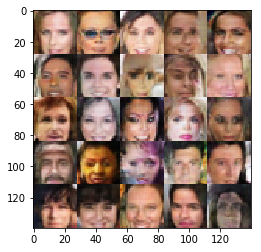

Epoch 6/10 Step 31700... Discriminator Loss: 0.8609... Generator Loss: 1.2551
Epoch 6/10 Step 31800... Discriminator Loss: 0.5363... Generator Loss: 2.5239


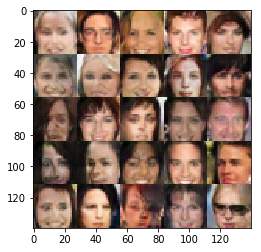

Epoch 6/10 Step 31900... Discriminator Loss: 0.8031... Generator Loss: 1.2163
Epoch 6/10 Step 32000... Discriminator Loss: 1.7631... Generator Loss: 3.4095


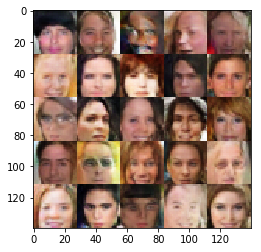

Epoch 6/10 Step 32100... Discriminator Loss: 1.0217... Generator Loss: 1.1085
Epoch 6/10 Step 32200... Discriminator Loss: 0.9359... Generator Loss: 1.0741


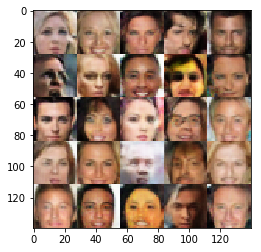

Epoch 6/10 Step 32300... Discriminator Loss: 2.1507... Generator Loss: 0.4082
Epoch 6/10 Step 32400... Discriminator Loss: 1.0450... Generator Loss: 0.9763


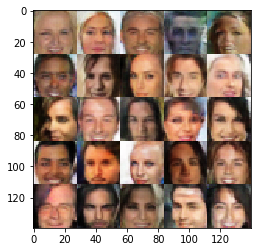

Epoch 6/10 Step 32500... Discriminator Loss: 0.7934... Generator Loss: 1.3160
Epoch 6/10 Step 32600... Discriminator Loss: 1.0552... Generator Loss: 1.0457


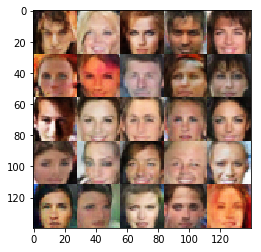

Epoch 6/10 Step 32700... Discriminator Loss: 0.9102... Generator Loss: 2.5983
Epoch 6/10 Step 32800... Discriminator Loss: 0.7988... Generator Loss: 1.3398


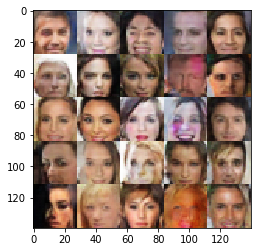

Epoch 6/10 Step 32900... Discriminator Loss: 1.0331... Generator Loss: 0.8516
Epoch 6/10 Step 33000... Discriminator Loss: 0.6532... Generator Loss: 1.5802


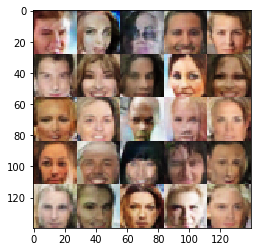

Epoch 6/10 Step 33100... Discriminator Loss: 1.0137... Generator Loss: 0.8071
Epoch 6/10 Step 33200... Discriminator Loss: 0.9565... Generator Loss: 0.9667


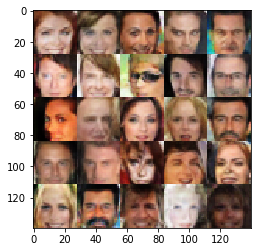

Epoch 6/10 Step 33300... Discriminator Loss: 0.7071... Generator Loss: 2.5036
Epoch 6/10 Step 33400... Discriminator Loss: 1.0760... Generator Loss: 0.8114


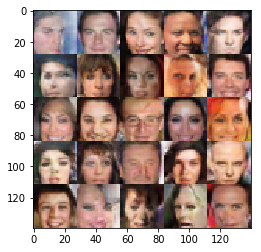

Epoch 6/10 Step 33500... Discriminator Loss: 0.6801... Generator Loss: 1.9907
Epoch 6/10 Step 33600... Discriminator Loss: 1.4403... Generator Loss: 3.3400


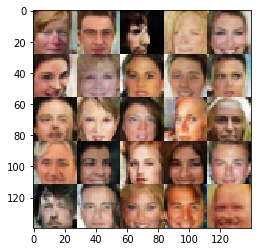

Epoch 6/10 Step 33700... Discriminator Loss: 0.5979... Generator Loss: 1.9115
Epoch 6/10 Step 33800... Discriminator Loss: 0.9910... Generator Loss: 1.0974


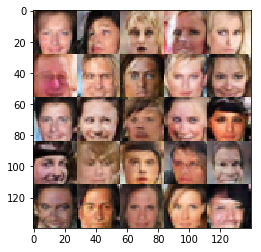

Epoch 6/10 Step 33900... Discriminator Loss: 0.7934... Generator Loss: 1.7183
Epoch 6/10 Step 34000... Discriminator Loss: 0.6431... Generator Loss: 1.5941


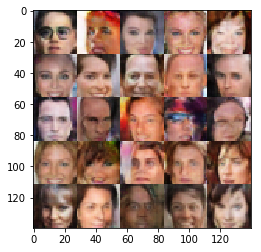

Epoch 6/10 Step 34100... Discriminator Loss: 2.2476... Generator Loss: 0.2372
Epoch 6/10 Step 34200... Discriminator Loss: 0.9412... Generator Loss: 3.0993


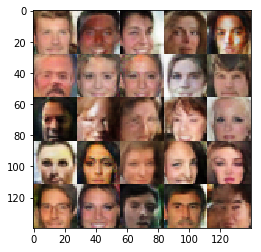

Epoch 6/10 Step 34300... Discriminator Loss: 0.9417... Generator Loss: 3.1435
Epoch 6/10 Step 34400... Discriminator Loss: 2.4584... Generator Loss: 0.2503


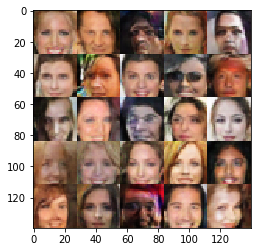

Epoch 6/10 Step 34500... Discriminator Loss: 0.5210... Generator Loss: 3.3778
Epoch 6/10 Step 34600... Discriminator Loss: 0.6833... Generator Loss: 1.7541


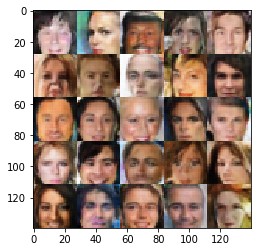

Epoch 6/10 Step 34700... Discriminator Loss: 0.7376... Generator Loss: 1.3908
Epoch 6/10 Step 34800... Discriminator Loss: 0.7019... Generator Loss: 1.8005


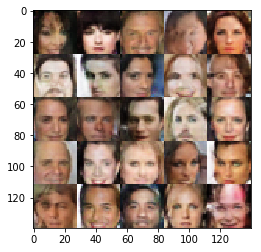

Epoch 6/10 Step 34900... Discriminator Loss: 1.6859... Generator Loss: 0.4736
Epoch 6/10 Step 35000... Discriminator Loss: 0.5928... Generator Loss: 1.9391


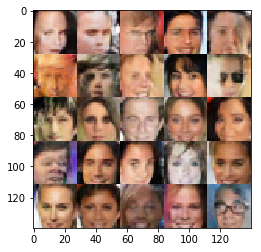

Epoch 6/10 Step 35100... Discriminator Loss: 0.7218... Generator Loss: 1.4890
Epoch 6/10 Step 35200... Discriminator Loss: 0.7318... Generator Loss: 2.1792


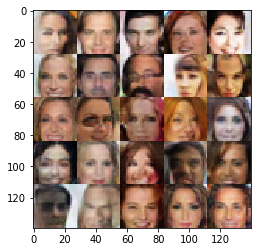

Epoch 6/10 Step 35300... Discriminator Loss: 0.6647... Generator Loss: 2.4026
Epoch 6/10 Step 35400... Discriminator Loss: 0.8431... Generator Loss: 1.1145


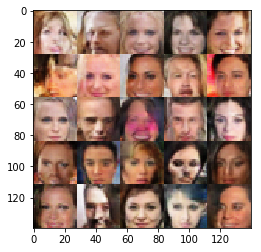

Epoch 6/10 Step 35500... Discriminator Loss: 0.8119... Generator Loss: 1.5010
Epoch 6/10 Step 35600... Discriminator Loss: 0.6751... Generator Loss: 1.7355


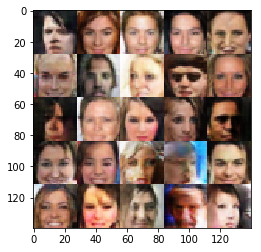

Epoch 6/10 Step 35700... Discriminator Loss: 0.8668... Generator Loss: 1.0609
Epoch 6/10 Step 35800... Discriminator Loss: 1.8374... Generator Loss: 0.3293


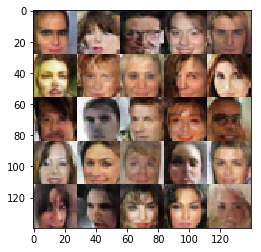

Epoch 6/10 Step 35900... Discriminator Loss: 1.2522... Generator Loss: 0.7236
Epoch 6/10 Step 36000... Discriminator Loss: 1.6819... Generator Loss: 0.4147


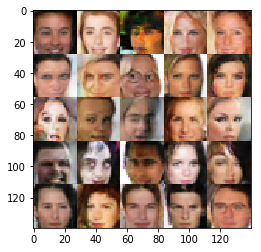

Epoch 6/10 Step 36100... Discriminator Loss: 1.0946... Generator Loss: 0.7784
Epoch 6/10 Step 36200... Discriminator Loss: 0.8985... Generator Loss: 1.0033


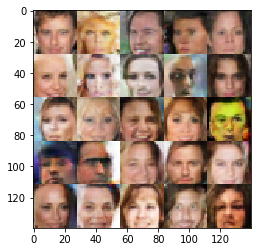

Epoch 6/10 Step 36300... Discriminator Loss: 1.2792... Generator Loss: 1.0159
Epoch 6/10 Step 36400... Discriminator Loss: 0.9592... Generator Loss: 1.0007


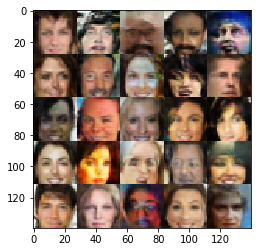

Epoch 6/10 Step 36500... Discriminator Loss: 0.7598... Generator Loss: 1.2884
Epoch 6/10 Step 36600... Discriminator Loss: 1.0782... Generator Loss: 0.7673


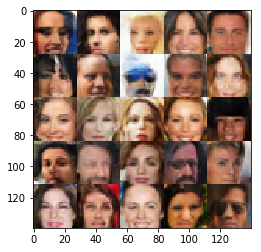

Epoch 6/10 Step 36700... Discriminator Loss: 0.8662... Generator Loss: 1.1094
Epoch 6/10 Step 36800... Discriminator Loss: 0.6505... Generator Loss: 1.6012


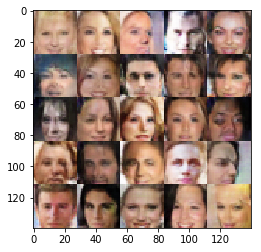

Epoch 6/10 Step 36900... Discriminator Loss: 1.1903... Generator Loss: 0.8436
Epoch 6/10 Step 37000... Discriminator Loss: 0.5224... Generator Loss: 2.0792


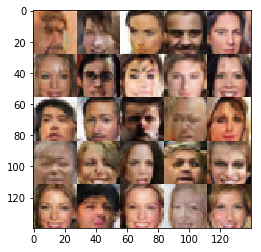

Epoch 6/10 Step 37100... Discriminator Loss: 0.6193... Generator Loss: 2.4627
Epoch 6/10 Step 37200... Discriminator Loss: 1.6228... Generator Loss: 0.4773


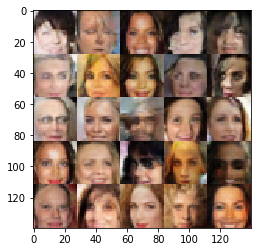

Epoch 6/10 Step 37300... Discriminator Loss: 0.8232... Generator Loss: 2.0502
Epoch 6/10 Step 37400... Discriminator Loss: 0.6754... Generator Loss: 1.6121


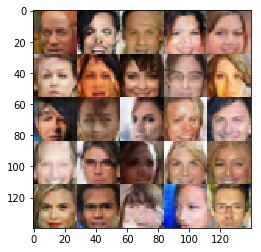

Epoch 6/10 Step 37500... Discriminator Loss: 0.6382... Generator Loss: 1.6276
Epoch 6/10 Step 37600... Discriminator Loss: 1.3941... Generator Loss: 0.6876


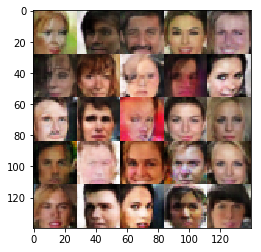

Epoch 6/10 Step 37700... Discriminator Loss: 0.7168... Generator Loss: 1.5036
Epoch 6/10 Step 37800... Discriminator Loss: 2.0296... Generator Loss: 0.2782


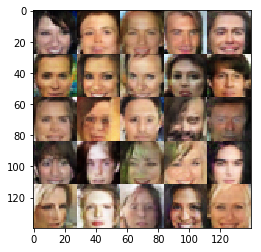

Epoch 6/10 Step 37900... Discriminator Loss: 0.9967... Generator Loss: 2.3119
Epoch 7/10 Step 38000... Discriminator Loss: 0.7205... Generator Loss: 1.4811


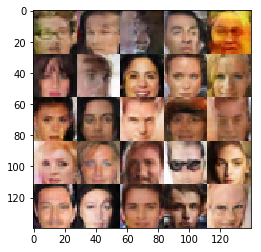

Epoch 7/10 Step 38100... Discriminator Loss: 0.7361... Generator Loss: 1.4775
Epoch 7/10 Step 38200... Discriminator Loss: 0.6258... Generator Loss: 2.8865


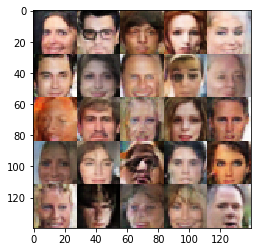

Epoch 7/10 Step 38300... Discriminator Loss: 0.9504... Generator Loss: 1.0417
Epoch 7/10 Step 38400... Discriminator Loss: 1.1429... Generator Loss: 0.9101


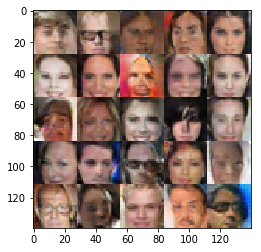

Epoch 7/10 Step 38500... Discriminator Loss: 0.6550... Generator Loss: 1.8414
Epoch 7/10 Step 38600... Discriminator Loss: 0.6672... Generator Loss: 1.6822


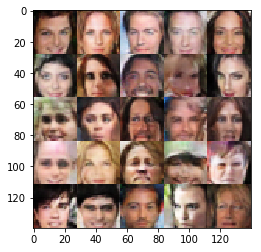

Epoch 7/10 Step 38700... Discriminator Loss: 0.8729... Generator Loss: 1.2008
Epoch 7/10 Step 38800... Discriminator Loss: 0.7056... Generator Loss: 1.4796


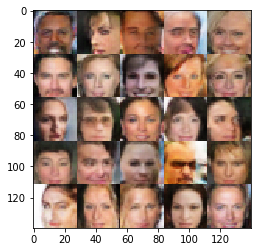

Epoch 7/10 Step 38900... Discriminator Loss: 0.8592... Generator Loss: 1.1025
Epoch 7/10 Step 39000... Discriminator Loss: 0.6194... Generator Loss: 2.0065


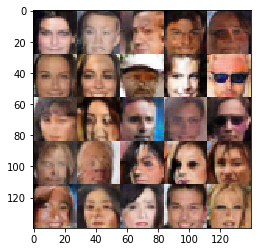

Epoch 7/10 Step 39100... Discriminator Loss: 0.8357... Generator Loss: 1.7914
Epoch 7/10 Step 39200... Discriminator Loss: 0.5784... Generator Loss: 2.3136


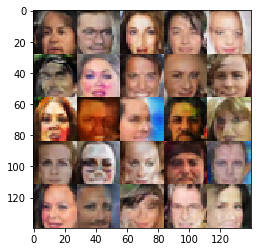

Epoch 7/10 Step 39300... Discriminator Loss: 1.3237... Generator Loss: 3.4328
Epoch 7/10 Step 39400... Discriminator Loss: 0.5509... Generator Loss: 2.1438


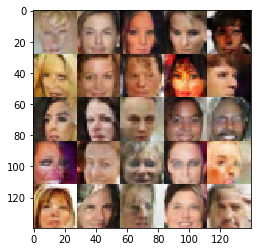

Epoch 7/10 Step 39500... Discriminator Loss: 1.1915... Generator Loss: 1.0882
Epoch 7/10 Step 39600... Discriminator Loss: 0.9101... Generator Loss: 1.2419


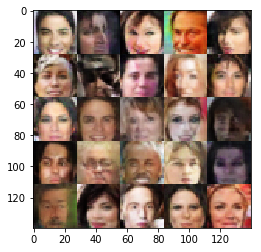

Epoch 7/10 Step 39700... Discriminator Loss: 0.8003... Generator Loss: 1.3129
Epoch 7/10 Step 39800... Discriminator Loss: 0.7293... Generator Loss: 1.4401


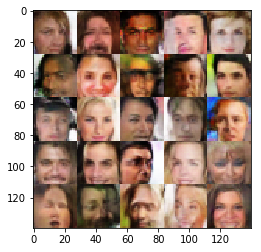

Epoch 7/10 Step 39900... Discriminator Loss: 0.7159... Generator Loss: 1.4072
Epoch 7/10 Step 40000... Discriminator Loss: 1.1277... Generator Loss: 0.9927


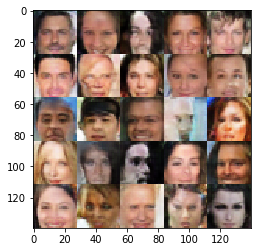

Epoch 7/10 Step 40100... Discriminator Loss: 0.5956... Generator Loss: 1.9784
Epoch 7/10 Step 40200... Discriminator Loss: 1.1719... Generator Loss: 0.6951


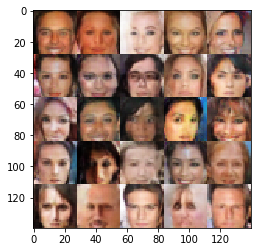

Epoch 7/10 Step 40300... Discriminator Loss: 0.6851... Generator Loss: 1.6077
Epoch 7/10 Step 40400... Discriminator Loss: 1.1342... Generator Loss: 0.8945


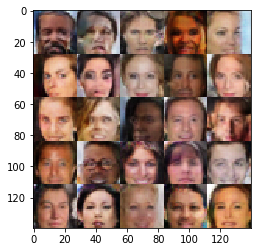

Epoch 7/10 Step 40500... Discriminator Loss: 0.8947... Generator Loss: 1.1272
Epoch 7/10 Step 40600... Discriminator Loss: 0.6487... Generator Loss: 1.9823


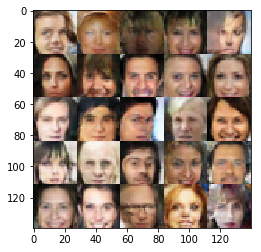

Epoch 7/10 Step 40700... Discriminator Loss: 0.9838... Generator Loss: 0.9045
Epoch 7/10 Step 40800... Discriminator Loss: 1.1096... Generator Loss: 0.7562


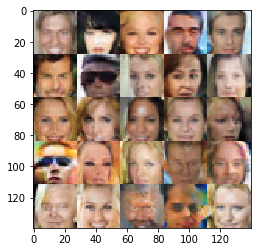

Epoch 7/10 Step 40900... Discriminator Loss: 0.6329... Generator Loss: 1.9233
Epoch 7/10 Step 41000... Discriminator Loss: 1.7375... Generator Loss: 0.4195


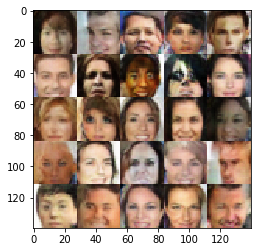

Epoch 7/10 Step 41100... Discriminator Loss: 0.7732... Generator Loss: 1.2385
Epoch 7/10 Step 41200... Discriminator Loss: 0.7633... Generator Loss: 1.3090


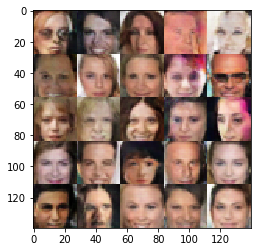

Epoch 7/10 Step 41300... Discriminator Loss: 0.5907... Generator Loss: 2.1132
Epoch 7/10 Step 41400... Discriminator Loss: 0.6130... Generator Loss: 1.7569


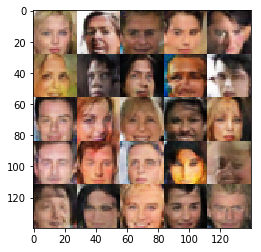

Epoch 7/10 Step 41500... Discriminator Loss: 0.9854... Generator Loss: 1.0441
Epoch 7/10 Step 41600... Discriminator Loss: 1.3391... Generator Loss: 0.6564


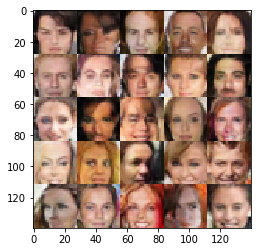

Epoch 7/10 Step 41700... Discriminator Loss: 1.3858... Generator Loss: 0.5473
Epoch 7/10 Step 41800... Discriminator Loss: 0.9843... Generator Loss: 1.0495


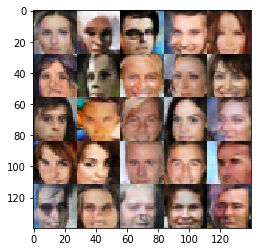

Epoch 7/10 Step 41900... Discriminator Loss: 1.0539... Generator Loss: 4.3205
Epoch 7/10 Step 42000... Discriminator Loss: 0.7302... Generator Loss: 1.4496


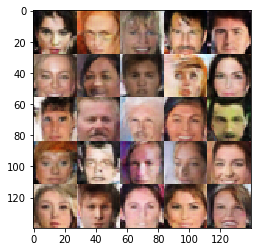

Epoch 7/10 Step 42100... Discriminator Loss: 1.6918... Generator Loss: 0.4966
Epoch 7/10 Step 42200... Discriminator Loss: 0.8221... Generator Loss: 1.2427


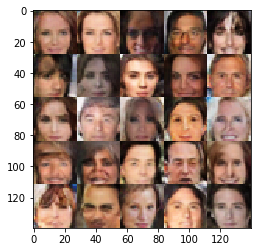

Epoch 7/10 Step 42300... Discriminator Loss: 1.7509... Generator Loss: 0.4802
Epoch 7/10 Step 42400... Discriminator Loss: 0.7422... Generator Loss: 1.4007


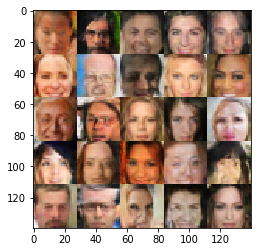

Epoch 7/10 Step 42500... Discriminator Loss: 0.6286... Generator Loss: 1.8677
Epoch 7/10 Step 42600... Discriminator Loss: 1.3853... Generator Loss: 0.6958


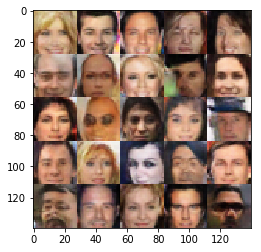

Epoch 7/10 Step 42700... Discriminator Loss: 0.6773... Generator Loss: 1.7653
Epoch 7/10 Step 42800... Discriminator Loss: 1.6568... Generator Loss: 0.5098


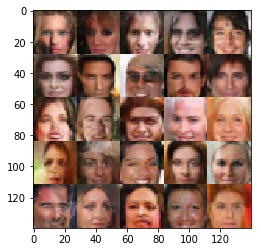

Epoch 7/10 Step 42900... Discriminator Loss: 0.5416... Generator Loss: 2.4628
Epoch 7/10 Step 43000... Discriminator Loss: 0.6812... Generator Loss: 2.3255


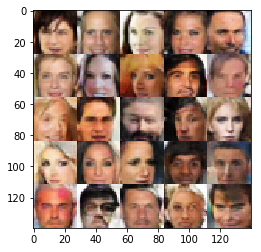

Epoch 7/10 Step 43100... Discriminator Loss: 0.6883... Generator Loss: 1.6445
Epoch 7/10 Step 43200... Discriminator Loss: 0.4338... Generator Loss: 2.8881


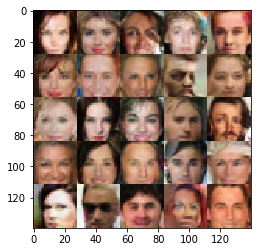

Epoch 7/10 Step 43300... Discriminator Loss: 0.8039... Generator Loss: 1.2160
Epoch 7/10 Step 43400... Discriminator Loss: 0.7530... Generator Loss: 4.0690


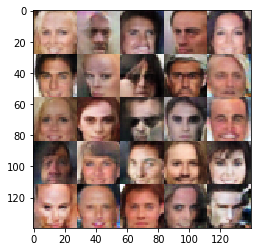

Epoch 7/10 Step 43500... Discriminator Loss: 0.9336... Generator Loss: 1.1304
Epoch 7/10 Step 43600... Discriminator Loss: 1.4491... Generator Loss: 0.6077


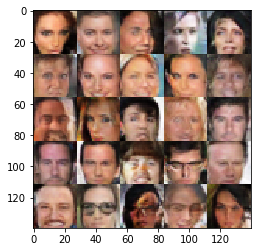

Epoch 7/10 Step 43700... Discriminator Loss: 1.1803... Generator Loss: 0.8469
Epoch 7/10 Step 43800... Discriminator Loss: 0.7094... Generator Loss: 1.4492


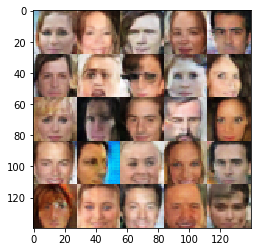

Epoch 7/10 Step 43900... Discriminator Loss: 0.9208... Generator Loss: 1.0405
Epoch 7/10 Step 44000... Discriminator Loss: 0.6280... Generator Loss: 1.9166


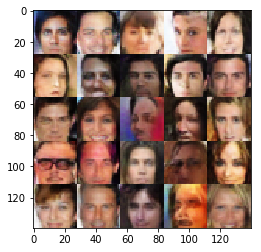

Epoch 7/10 Step 44100... Discriminator Loss: 0.6399... Generator Loss: 3.0814
Epoch 7/10 Step 44200... Discriminator Loss: 0.7928... Generator Loss: 1.3418


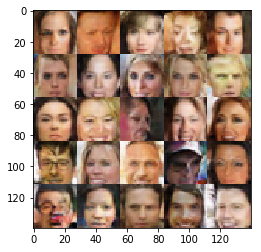

Epoch 7/10 Step 44300... Discriminator Loss: 0.8053... Generator Loss: 1.3907
Epoch 8/10 Step 44400... Discriminator Loss: 1.1632... Generator Loss: 0.7273


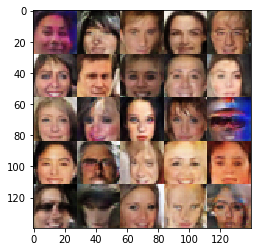

Epoch 8/10 Step 44500... Discriminator Loss: 0.7211... Generator Loss: 1.5915
Epoch 8/10 Step 44600... Discriminator Loss: 1.4737... Generator Loss: 0.6033


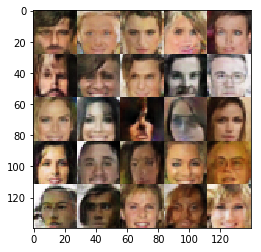

Epoch 8/10 Step 44700... Discriminator Loss: 1.8922... Generator Loss: 0.4808
Epoch 8/10 Step 44800... Discriminator Loss: 1.2955... Generator Loss: 0.8293


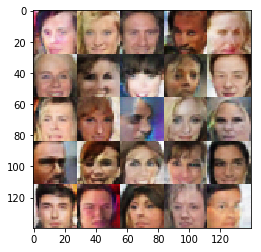

Epoch 8/10 Step 44900... Discriminator Loss: 0.9239... Generator Loss: 1.0688
Epoch 8/10 Step 45000... Discriminator Loss: 1.0344... Generator Loss: 0.8987


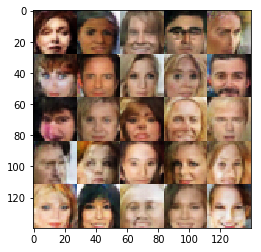

Epoch 8/10 Step 45100... Discriminator Loss: 1.0195... Generator Loss: 1.0907
Epoch 8/10 Step 45200... Discriminator Loss: 0.9294... Generator Loss: 1.2095


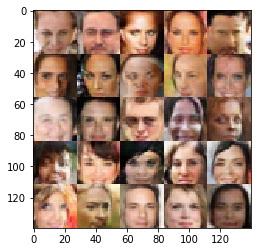

Epoch 8/10 Step 45300... Discriminator Loss: 1.3671... Generator Loss: 0.6116
Epoch 8/10 Step 45400... Discriminator Loss: 1.6798... Generator Loss: 0.4698


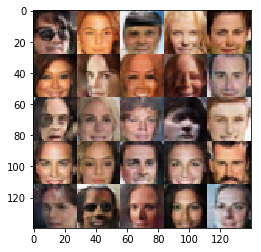

Epoch 8/10 Step 45500... Discriminator Loss: 0.8033... Generator Loss: 1.2966
Epoch 8/10 Step 45600... Discriminator Loss: 2.5799... Generator Loss: 0.1859


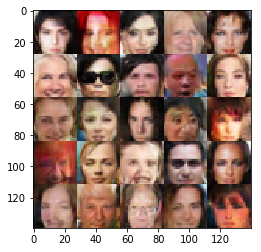

Epoch 8/10 Step 45700... Discriminator Loss: 1.0025... Generator Loss: 0.9854
Epoch 8/10 Step 45800... Discriminator Loss: 0.5427... Generator Loss: 2.2179


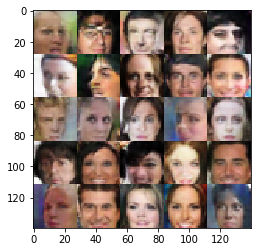

Epoch 8/10 Step 45900... Discriminator Loss: 1.0139... Generator Loss: 0.8887
Epoch 8/10 Step 46000... Discriminator Loss: 0.5752... Generator Loss: 1.9674


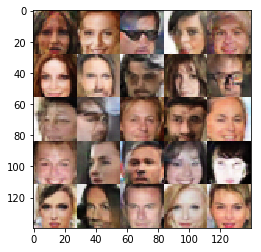

Epoch 8/10 Step 46100... Discriminator Loss: 0.6345... Generator Loss: 1.7267
Epoch 8/10 Step 46200... Discriminator Loss: 0.6867... Generator Loss: 1.6660


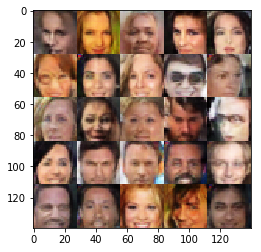

Epoch 8/10 Step 46300... Discriminator Loss: 1.4025... Generator Loss: 0.6027
Epoch 8/10 Step 46400... Discriminator Loss: 0.7325... Generator Loss: 1.9731


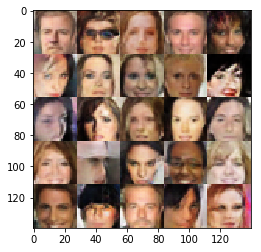

Epoch 8/10 Step 46500... Discriminator Loss: 0.4740... Generator Loss: 2.8785
Epoch 8/10 Step 46600... Discriminator Loss: 0.5458... Generator Loss: 2.3891


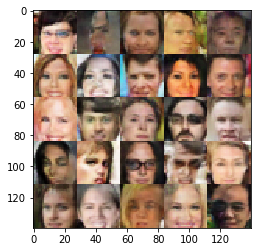

Epoch 8/10 Step 46700... Discriminator Loss: 0.9229... Generator Loss: 1.0348
Epoch 8/10 Step 46800... Discriminator Loss: 0.8217... Generator Loss: 1.1777


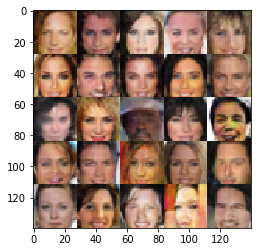

Epoch 8/10 Step 46900... Discriminator Loss: 1.7833... Generator Loss: 0.4232
Epoch 8/10 Step 47000... Discriminator Loss: 0.8523... Generator Loss: 1.1632


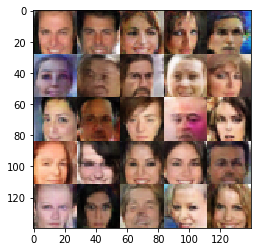

Epoch 8/10 Step 47100... Discriminator Loss: 1.6056... Generator Loss: 0.4751
Epoch 8/10 Step 47200... Discriminator Loss: 0.7186... Generator Loss: 1.4608


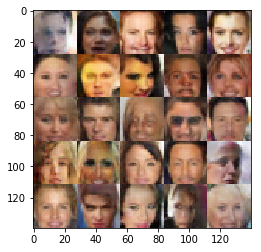

Epoch 8/10 Step 47300... Discriminator Loss: 0.6587... Generator Loss: 2.3114
Epoch 8/10 Step 47400... Discriminator Loss: 1.3675... Generator Loss: 0.7101


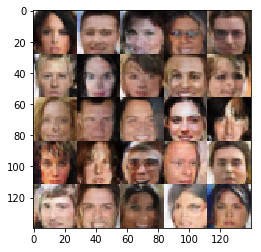

Epoch 8/10 Step 47500... Discriminator Loss: 0.7599... Generator Loss: 1.5897
Epoch 8/10 Step 47600... Discriminator Loss: 0.6283... Generator Loss: 3.2758


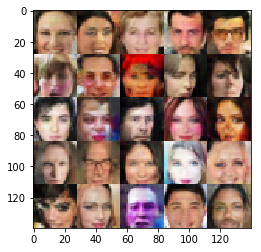

Epoch 8/10 Step 47700... Discriminator Loss: 0.5419... Generator Loss: 2.1798
Epoch 8/10 Step 47800... Discriminator Loss: 1.5005... Generator Loss: 0.6452


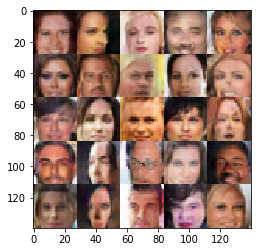

Epoch 8/10 Step 47900... Discriminator Loss: 0.6655... Generator Loss: 1.5041
Epoch 8/10 Step 48000... Discriminator Loss: 1.1949... Generator Loss: 3.4646


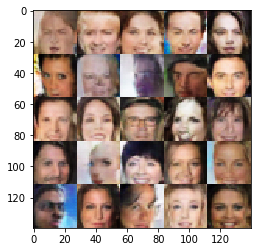

Epoch 8/10 Step 48100... Discriminator Loss: 0.5915... Generator Loss: 1.9939
Epoch 8/10 Step 48200... Discriminator Loss: 0.8812... Generator Loss: 1.1059


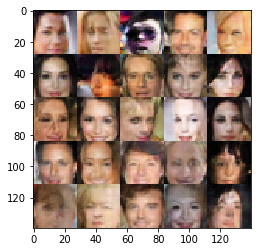

Epoch 8/10 Step 48300... Discriminator Loss: 0.5365... Generator Loss: 2.7840
Epoch 8/10 Step 48400... Discriminator Loss: 0.7264... Generator Loss: 1.4020


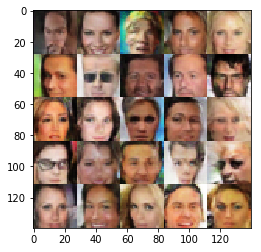

Epoch 8/10 Step 48500... Discriminator Loss: 0.7442... Generator Loss: 1.2551
Epoch 8/10 Step 48600... Discriminator Loss: 0.4645... Generator Loss: 2.6553


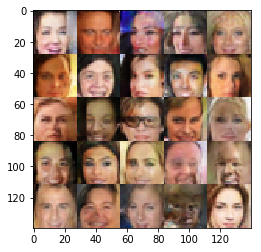

Epoch 8/10 Step 48700... Discriminator Loss: 0.5474... Generator Loss: 2.2150
Epoch 8/10 Step 48800... Discriminator Loss: 1.2481... Generator Loss: 0.9378


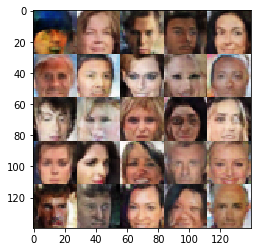

Epoch 8/10 Step 48900... Discriminator Loss: 0.5225... Generator Loss: 2.6794
Epoch 8/10 Step 49000... Discriminator Loss: 0.7858... Generator Loss: 1.2893


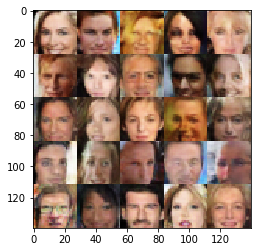

Epoch 8/10 Step 49100... Discriminator Loss: 0.5489... Generator Loss: 2.2406
Epoch 8/10 Step 49200... Discriminator Loss: 1.3058... Generator Loss: 0.6956


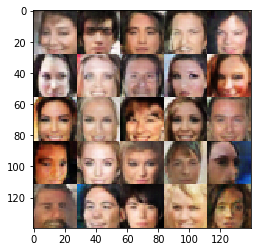

Epoch 8/10 Step 49300... Discriminator Loss: 1.1746... Generator Loss: 0.7823
Epoch 8/10 Step 49400... Discriminator Loss: 0.8598... Generator Loss: 1.0916


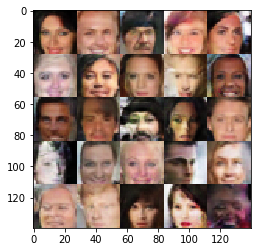

Epoch 8/10 Step 49500... Discriminator Loss: 0.7002... Generator Loss: 1.5391
Epoch 8/10 Step 49600... Discriminator Loss: 1.1860... Generator Loss: 0.7397


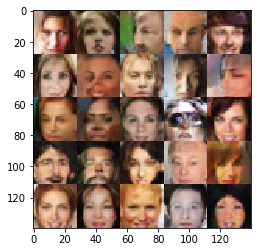

Epoch 8/10 Step 49700... Discriminator Loss: 0.9526... Generator Loss: 1.1005
Epoch 8/10 Step 49800... Discriminator Loss: 1.6405... Generator Loss: 0.6389


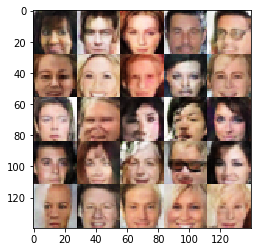

Epoch 8/10 Step 49900... Discriminator Loss: 1.8587... Generator Loss: 0.3792
Epoch 8/10 Step 50000... Discriminator Loss: 0.5713... Generator Loss: 1.8689


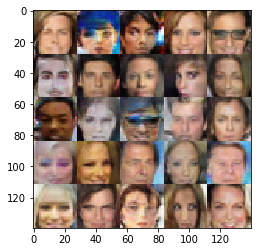

Epoch 8/10 Step 50100... Discriminator Loss: 0.7247... Generator Loss: 1.5651
Epoch 8/10 Step 50200... Discriminator Loss: 0.9559... Generator Loss: 2.5731


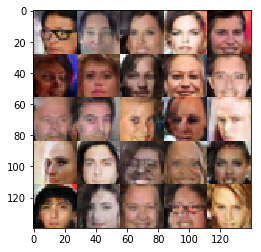

Epoch 8/10 Step 50300... Discriminator Loss: 0.7255... Generator Loss: 1.5487
Epoch 8/10 Step 50400... Discriminator Loss: 1.4907... Generator Loss: 0.4906


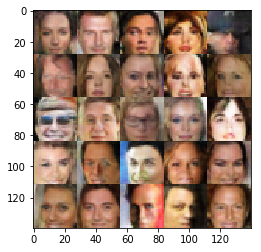

Epoch 8/10 Step 50500... Discriminator Loss: 0.7789... Generator Loss: 1.3099
Epoch 8/10 Step 50600... Discriminator Loss: 0.5064... Generator Loss: 2.2839


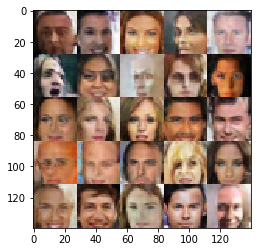

Epoch 9/10 Step 50700... Discriminator Loss: 0.7047... Generator Loss: 1.5389
Epoch 9/10 Step 50800... Discriminator Loss: 0.9918... Generator Loss: 1.0665


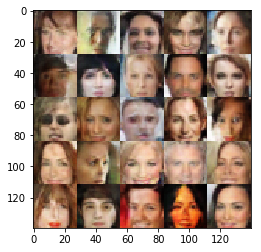

Epoch 9/10 Step 50900... Discriminator Loss: 0.5111... Generator Loss: 2.4238
Epoch 9/10 Step 51000... Discriminator Loss: 1.2148... Generator Loss: 0.7550


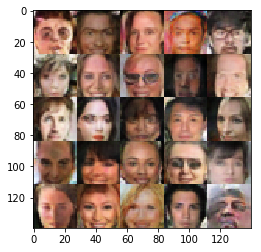

Epoch 9/10 Step 51100... Discriminator Loss: 0.5562... Generator Loss: 2.3014
Epoch 9/10 Step 51200... Discriminator Loss: 1.9434... Generator Loss: 0.5068


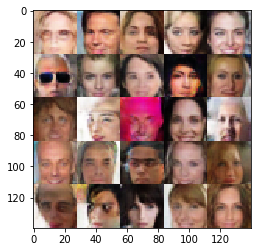

Epoch 9/10 Step 51300... Discriminator Loss: 0.6882... Generator Loss: 1.6179
Epoch 9/10 Step 51400... Discriminator Loss: 0.5877... Generator Loss: 2.4592


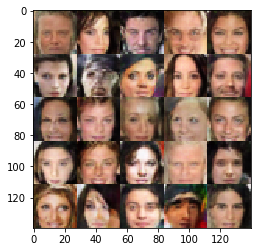

Epoch 9/10 Step 51500... Discriminator Loss: 1.3319... Generator Loss: 0.6303
Epoch 9/10 Step 51600... Discriminator Loss: 0.6128... Generator Loss: 2.0788


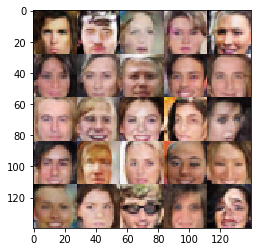

Epoch 9/10 Step 51700... Discriminator Loss: 0.8069... Generator Loss: 2.4452
Epoch 9/10 Step 51800... Discriminator Loss: 0.9990... Generator Loss: 1.0316


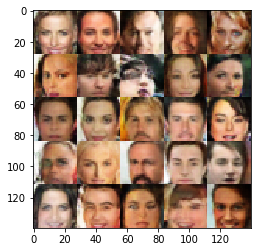

Epoch 9/10 Step 51900... Discriminator Loss: 0.8729... Generator Loss: 1.2370
Epoch 9/10 Step 52000... Discriminator Loss: 2.3923... Generator Loss: 0.2461


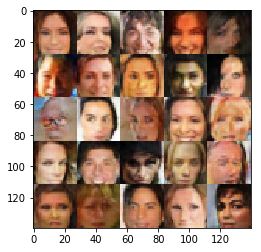

Epoch 9/10 Step 52100... Discriminator Loss: 1.2806... Generator Loss: 0.6515
Epoch 9/10 Step 52200... Discriminator Loss: 2.3641... Generator Loss: 0.3309


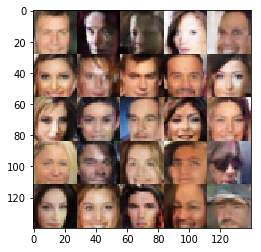

Epoch 9/10 Step 52300... Discriminator Loss: 0.6076... Generator Loss: 3.1092
Epoch 9/10 Step 52400... Discriminator Loss: 0.6651... Generator Loss: 1.7076


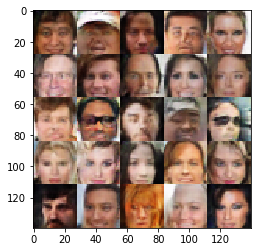

Epoch 9/10 Step 52500... Discriminator Loss: 1.1397... Generator Loss: 0.9159
Epoch 9/10 Step 52600... Discriminator Loss: 0.4733... Generator Loss: 2.6439


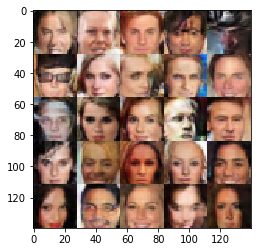

Epoch 9/10 Step 52700... Discriminator Loss: 1.7504... Generator Loss: 0.4513
Epoch 9/10 Step 52800... Discriminator Loss: 0.9061... Generator Loss: 1.1345


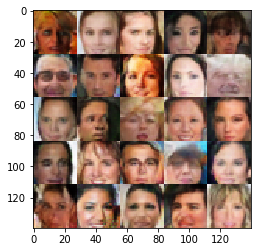

Epoch 9/10 Step 52900... Discriminator Loss: 1.8791... Generator Loss: 0.3639
Epoch 9/10 Step 53000... Discriminator Loss: 0.5448... Generator Loss: 2.0661


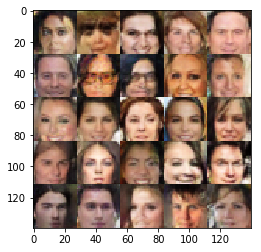

Epoch 9/10 Step 53100... Discriminator Loss: 0.9118... Generator Loss: 1.0777
Epoch 9/10 Step 53200... Discriminator Loss: 1.3383... Generator Loss: 0.6871


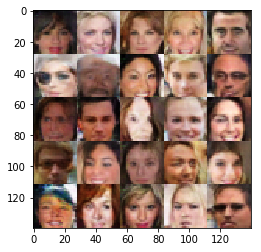

Epoch 9/10 Step 53300... Discriminator Loss: 0.9088... Generator Loss: 1.1200
Epoch 9/10 Step 53400... Discriminator Loss: 0.8056... Generator Loss: 1.2423


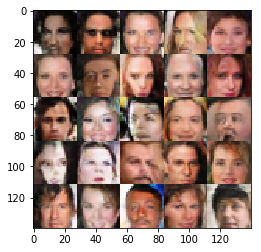

Epoch 9/10 Step 53500... Discriminator Loss: 0.8661... Generator Loss: 1.1236
Epoch 9/10 Step 53600... Discriminator Loss: 1.6518... Generator Loss: 0.4956


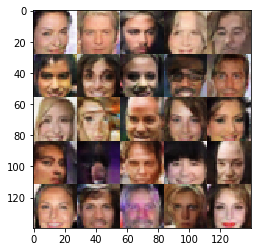

Epoch 9/10 Step 53700... Discriminator Loss: 0.7099... Generator Loss: 1.4961
Epoch 9/10 Step 53800... Discriminator Loss: 1.5771... Generator Loss: 0.4783


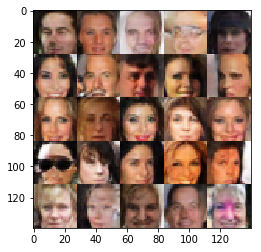

Epoch 9/10 Step 53900... Discriminator Loss: 0.6318... Generator Loss: 1.7273
Epoch 9/10 Step 54000... Discriminator Loss: 0.8622... Generator Loss: 1.2874


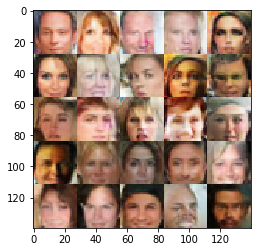

Epoch 9/10 Step 54100... Discriminator Loss: 1.5353... Generator Loss: 0.4735
Epoch 9/10 Step 54200... Discriminator Loss: 1.0647... Generator Loss: 1.0483


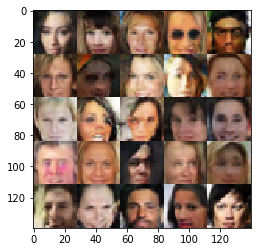

Epoch 9/10 Step 54300... Discriminator Loss: 0.9301... Generator Loss: 1.3848
Epoch 9/10 Step 54400... Discriminator Loss: 0.9220... Generator Loss: 1.1317


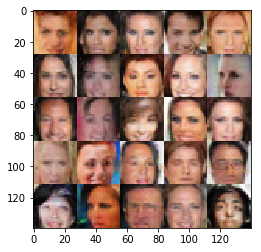

Epoch 9/10 Step 54500... Discriminator Loss: 0.9760... Generator Loss: 0.9569
Epoch 9/10 Step 54600... Discriminator Loss: 0.6954... Generator Loss: 1.6799


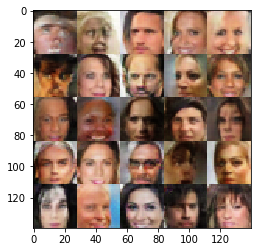

Epoch 9/10 Step 54700... Discriminator Loss: 0.5271... Generator Loss: 2.2214
Epoch 9/10 Step 54800... Discriminator Loss: 0.7095... Generator Loss: 1.5272


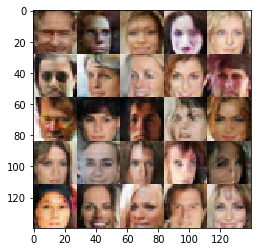

Epoch 9/10 Step 54900... Discriminator Loss: 0.9469... Generator Loss: 0.9855
Epoch 9/10 Step 55000... Discriminator Loss: 1.0324... Generator Loss: 0.9756


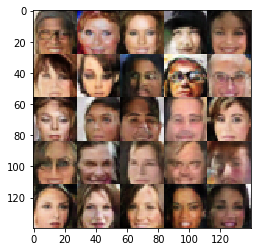

Epoch 9/10 Step 55100... Discriminator Loss: 1.1574... Generator Loss: 0.8563
Epoch 9/10 Step 55200... Discriminator Loss: 0.8511... Generator Loss: 1.1370


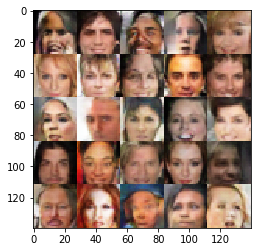

Epoch 9/10 Step 55300... Discriminator Loss: 0.8288... Generator Loss: 2.6217
Epoch 9/10 Step 55400... Discriminator Loss: 0.8277... Generator Loss: 1.2486


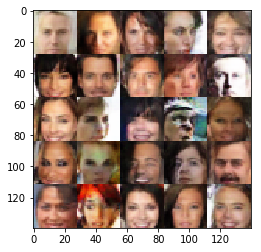

Epoch 9/10 Step 55500... Discriminator Loss: 1.0330... Generator Loss: 1.1244
Epoch 9/10 Step 55600... Discriminator Loss: 0.6100... Generator Loss: 2.0386


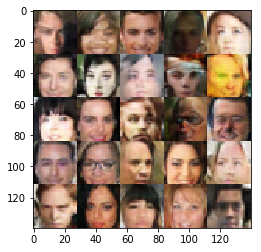

Epoch 9/10 Step 55700... Discriminator Loss: 1.1726... Generator Loss: 0.8141
Epoch 9/10 Step 55800... Discriminator Loss: 1.6983... Generator Loss: 0.6233


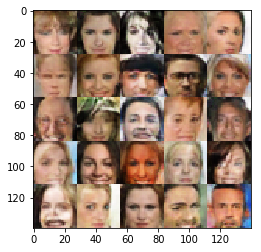

Epoch 9/10 Step 55900... Discriminator Loss: 1.0139... Generator Loss: 0.9258
Epoch 9/10 Step 56000... Discriminator Loss: 1.1031... Generator Loss: 0.8873


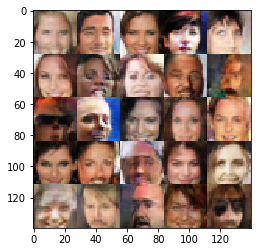

Epoch 9/10 Step 56100... Discriminator Loss: 0.4083... Generator Loss: 3.3215
Epoch 9/10 Step 56200... Discriminator Loss: 1.6687... Generator Loss: 0.5406


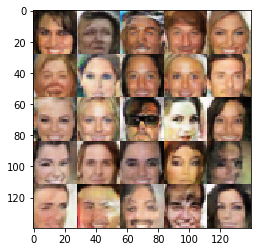

Epoch 9/10 Step 56300... Discriminator Loss: 0.6188... Generator Loss: 1.9518
Epoch 9/10 Step 56400... Discriminator Loss: 1.3363... Generator Loss: 0.7022


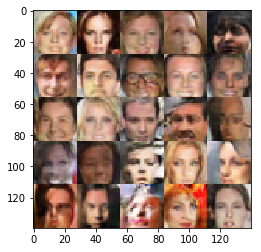

Epoch 9/10 Step 56500... Discriminator Loss: 0.5831... Generator Loss: 2.1543
Epoch 9/10 Step 56600... Discriminator Loss: 0.6571... Generator Loss: 1.8625


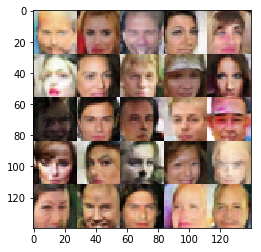

Epoch 9/10 Step 56700... Discriminator Loss: 1.5296... Generator Loss: 0.4758
Epoch 9/10 Step 56800... Discriminator Loss: 0.6434... Generator Loss: 1.9112


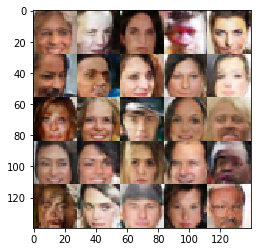

Epoch 9/10 Step 56900... Discriminator Loss: 0.6037... Generator Loss: 1.9649
Epoch 10/10 Step 57000... Discriminator Loss: 2.1146... Generator Loss: 0.2872


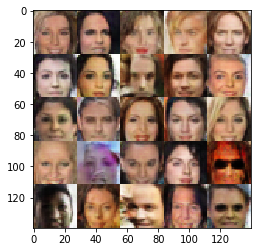

Epoch 10/10 Step 57100... Discriminator Loss: 1.0855... Generator Loss: 1.0421
Epoch 10/10 Step 57200... Discriminator Loss: 1.1315... Generator Loss: 0.8772


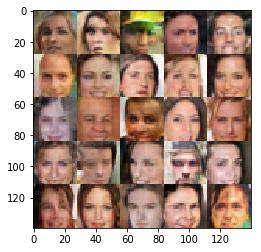

Epoch 10/10 Step 57300... Discriminator Loss: 0.7145... Generator Loss: 1.4683
Epoch 10/10 Step 57400... Discriminator Loss: 0.8356... Generator Loss: 1.5581


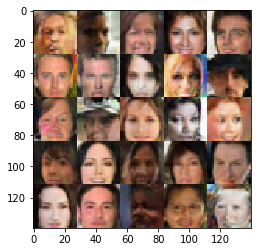

Epoch 10/10 Step 57500... Discriminator Loss: 0.9249... Generator Loss: 1.0939
Epoch 10/10 Step 57600... Discriminator Loss: 1.2019... Generator Loss: 1.0647


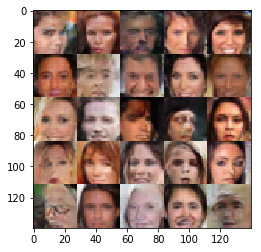

Epoch 10/10 Step 57700... Discriminator Loss: 0.7897... Generator Loss: 1.3651
Epoch 10/10 Step 57800... Discriminator Loss: 0.7975... Generator Loss: 2.2803


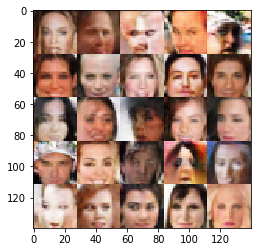

Epoch 10/10 Step 57900... Discriminator Loss: 0.9299... Generator Loss: 0.9286
Epoch 10/10 Step 58000... Discriminator Loss: 0.8018... Generator Loss: 1.2856


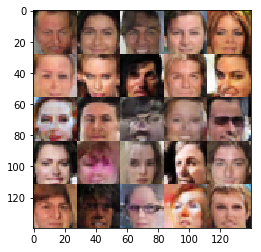

Epoch 10/10 Step 58100... Discriminator Loss: 0.6187... Generator Loss: 1.8305
Epoch 10/10 Step 58200... Discriminator Loss: 0.7687... Generator Loss: 1.4293


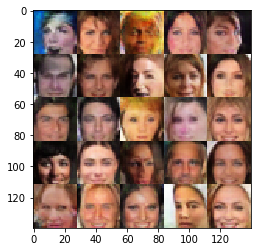

Epoch 10/10 Step 58300... Discriminator Loss: 0.6320... Generator Loss: 1.7149
Epoch 10/10 Step 58400... Discriminator Loss: 1.2059... Generator Loss: 0.8020


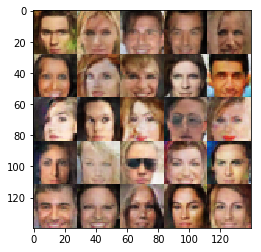

Epoch 10/10 Step 58500... Discriminator Loss: 1.4045... Generator Loss: 0.6571
Epoch 10/10 Step 58600... Discriminator Loss: 1.0276... Generator Loss: 1.2169


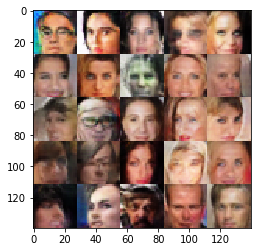

Epoch 10/10 Step 58700... Discriminator Loss: 0.6794... Generator Loss: 1.4814
Epoch 10/10 Step 58800... Discriminator Loss: 0.9420... Generator Loss: 1.0028


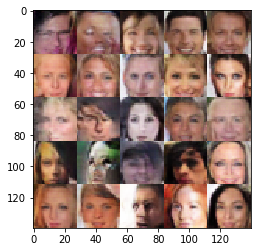

Epoch 10/10 Step 58900... Discriminator Loss: 0.8761... Generator Loss: 1.3277
Epoch 10/10 Step 59000... Discriminator Loss: 0.5605... Generator Loss: 2.2100


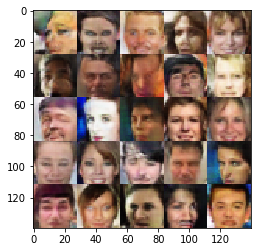

Epoch 10/10 Step 59100... Discriminator Loss: 0.8971... Generator Loss: 1.2482
Epoch 10/10 Step 59200... Discriminator Loss: 1.6133... Generator Loss: 0.5205


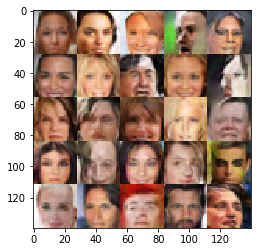

Epoch 10/10 Step 59300... Discriminator Loss: 0.8476... Generator Loss: 1.2406
Epoch 10/10 Step 59400... Discriminator Loss: 1.1200... Generator Loss: 0.8735


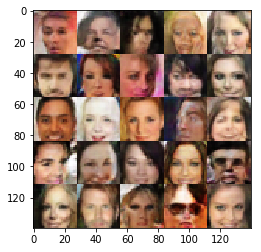

Epoch 10/10 Step 59500... Discriminator Loss: 1.0052... Generator Loss: 0.9114
Epoch 10/10 Step 59600... Discriminator Loss: 1.4345... Generator Loss: 0.5704


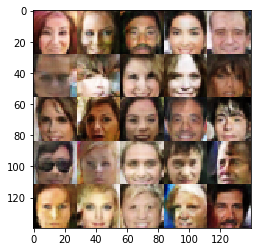

Epoch 10/10 Step 59700... Discriminator Loss: 0.7356... Generator Loss: 1.5023
Epoch 10/10 Step 59800... Discriminator Loss: 0.6266... Generator Loss: 1.8036


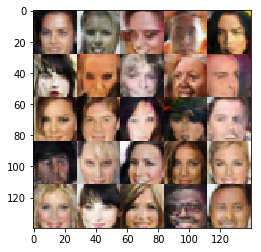

Epoch 10/10 Step 59900... Discriminator Loss: 1.3914... Generator Loss: 0.6166
Epoch 10/10 Step 60000... Discriminator Loss: 0.7308... Generator Loss: 1.6099


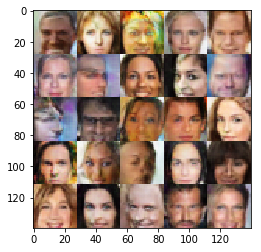

Epoch 10/10 Step 60100... Discriminator Loss: 0.5429... Generator Loss: 2.3140
Epoch 10/10 Step 60200... Discriminator Loss: 1.5679... Generator Loss: 0.4557


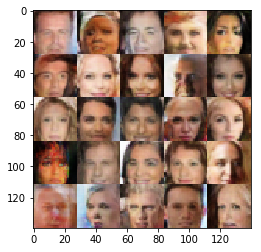

Epoch 10/10 Step 60300... Discriminator Loss: 0.7911... Generator Loss: 1.2125
Epoch 10/10 Step 60400... Discriminator Loss: 0.6989... Generator Loss: 1.6028


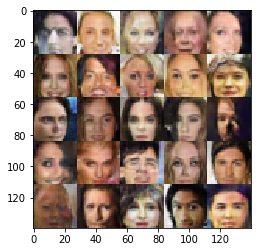

Epoch 10/10 Step 60500... Discriminator Loss: 0.5813... Generator Loss: 2.0570
Epoch 10/10 Step 60600... Discriminator Loss: 1.7699... Generator Loss: 0.3796


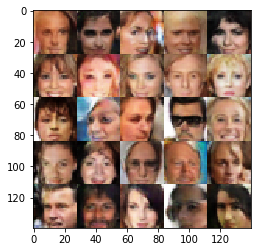

Epoch 10/10 Step 60700... Discriminator Loss: 0.5967... Generator Loss: 2.3206
Epoch 10/10 Step 60800... Discriminator Loss: 0.6358... Generator Loss: 2.0914


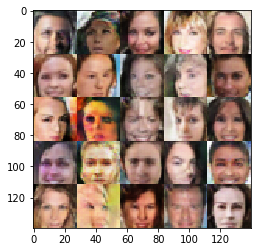

Epoch 10/10 Step 60900... Discriminator Loss: 2.7750... Generator Loss: 0.1687
Epoch 10/10 Step 61000... Discriminator Loss: 0.7588... Generator Loss: 1.3236


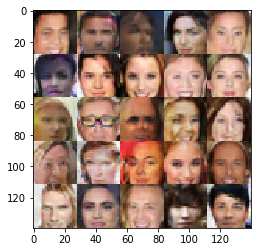

Epoch 10/10 Step 61100... Discriminator Loss: 2.2325... Generator Loss: 0.3147
Epoch 10/10 Step 61200... Discriminator Loss: 0.8591... Generator Loss: 1.1037


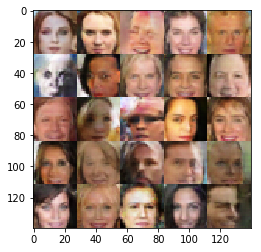

Epoch 10/10 Step 61300... Discriminator Loss: 0.9779... Generator Loss: 0.9986
Epoch 10/10 Step 61400... Discriminator Loss: 0.8037... Generator Loss: 1.4055


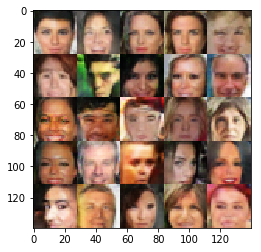

Epoch 10/10 Step 61500... Discriminator Loss: 1.1644... Generator Loss: 0.8059
Epoch 10/10 Step 61600... Discriminator Loss: 0.4529... Generator Loss: 2.7746


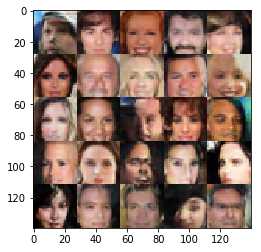

Epoch 10/10 Step 61700... Discriminator Loss: 0.9125... Generator Loss: 1.1082
Epoch 10/10 Step 61800... Discriminator Loss: 0.7561... Generator Loss: 1.4556


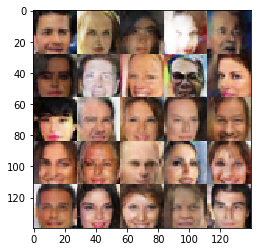

Epoch 10/10 Step 61900... Discriminator Loss: 0.9655... Generator Loss: 1.0411
Epoch 10/10 Step 62000... Discriminator Loss: 0.7079... Generator Loss: 1.4676


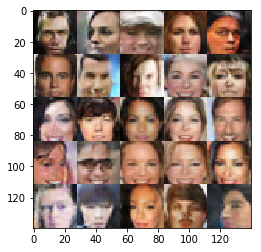

Epoch 10/10 Step 62100... Discriminator Loss: 0.9433... Generator Loss: 1.0513
Epoch 10/10 Step 62200... Discriminator Loss: 1.4587... Generator Loss: 0.5290


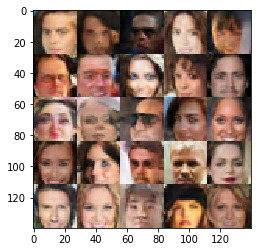

Epoch 10/10 Step 62300... Discriminator Loss: 1.3383... Generator Loss: 0.5928
Epoch 10/10 Step 62400... Discriminator Loss: 0.5895... Generator Loss: 2.4376


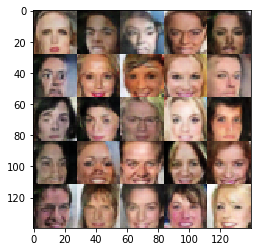

Epoch 10/10 Step 62500... Discriminator Loss: 0.6965... Generator Loss: 1.4281
Epoch 10/10 Step 62600... Discriminator Loss: 0.7411... Generator Loss: 1.3608


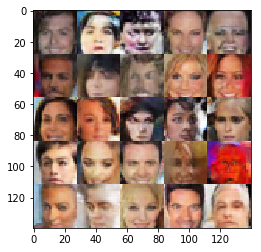

Epoch 10/10 Step 62700... Discriminator Loss: 1.4154... Generator Loss: 0.6345
Epoch 10/10 Step 62800... Discriminator Loss: 0.7511... Generator Loss: 1.4907


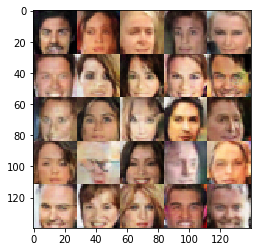

Epoch 10/10 Step 62900... Discriminator Loss: 0.6478... Generator Loss: 1.6820
Epoch 10/10 Step 63000... Discriminator Loss: 1.2335... Generator Loss: 0.8975


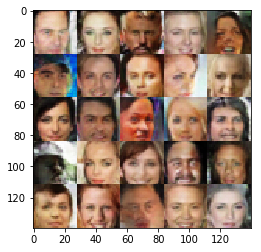

Epoch 10/10 Step 63100... Discriminator Loss: 0.8071... Generator Loss: 1.3633
Epoch 10/10 Step 63200... Discriminator Loss: 1.4720... Generator Loss: 0.6676


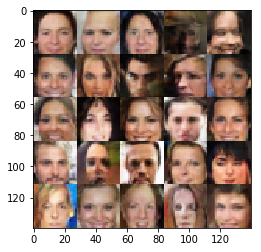

Epoch 10/10 Step 63300... Discriminator Loss: 0.9637... Generator Loss: 0.9741


In [13]:
batch_size = 32
z_dim = 100
learning_rate = 0.0005
beta1 = 0.4


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 10

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.